# Настройка Colab
Выполним подключение к Google Диску для доступа к файлам .py и данным.

In [23]:
!pwd

/home/ilya/maga/DL/1/Lab_GAN


In [22]:
import os
datadir = "Lab_GAN/"
os.chdir(datadir)
!pwd

FileNotFoundError: [Errno 2] No such file or directory: 'Lab_GAN/'

# Генеративные состязательные сети (Generative Adversarial Networks)
Сначала необходимо реализовать два разных типа генеративных состязательных сетей. Будем обучаться на базе изображений кошек.

In [24]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # установим размер графиков по умолчанию
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [25]:
from gan.train import train

In [26]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Функции потерь GAN (GAN loss functions)

Необходимо реализовывать две разные функции потерь GAN: как в [оригинальной статье о GAN](http://arxiv.org/pdf/1406.2661.pdf) и как в [LS-GAN](https://arxiv.org/abs/1611.04076).

### Функции потерь GAN

**TODO:** Реализуйте функции `discriminator_loss` и `generator_loss` in файле `gan/losses.py`.

Функция потерь генератора определяется как:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
и функция потерь дискриминатора равна:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$

Обратите внимание на знак минус в уравнениях, поскольку мы будем *минимизировать* эти функции потерь.



**HINTS**: Следует использовать функцию `torch.nn.functional.binary_cross_entropy_with_logits` для вычисления бинарной кросс-энтропии, поскольку эта функция численно более стабильна, чем использование softmax, за которой следует BCE.




Пусть оценка (score) $s\in\mathbb{R}$ и метка $y\in\{0, 1\}$, бинарная кросс-энтропия равна

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$

Тогда
$$\ell_G = bce(D(G(z)), 1)$$

Первое слагаемое в $\ell_D$ равно
$$bce(D(x), 1)$$


Второе слагаемое в $\ell_D$ равно
$$bce(1-D(G(z)), 1) = bce(D(G(z)), 0)$$

Вместо вычисления математического ожидания для $\log D(G(z))$, $\log D(x)$ и $\log \left(1-D(G(z))\right)$, будем выполнять усреднение по элементам минибатча, поэтому убедитесь, что объединяете потери путем усреднения, а не суммирования.

In [27]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss (функция потерь GAN по методу наименьших квадратов)

**TODO:** Реализуйте функции `ls_discriminator_loss` и `ls_generator_loss` в файле `gan/losses.py`.


Теперь рассмотрим [Least Squares GAN](https://arxiv.org/abs/1611.04076), более новую и стабильную альтернативу исходной функции потерь GAN. Все, что нужно сделать, это изменить функцию потерь и переобучить модель. Функция потерь генератора для этого случая равна:


$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
функция потерь дискриминатора:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$



**HINTS**: Вместо вычисления математического ожидания мы будем выполнять усреднение по элементам минибатча, поэтому не забудьте объединить потери путем усреднения, а не суммирования. При подстановке значений для $D(x)$ и $D(G(z))$ используйте непосредственно выходные значения дискриминатора (`scores_real` и `scores_fake`).

In [28]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# Архитектура модели GAN

**TODO:** Реализуйте классы the `Discriminator` и `Generator` в файле `gan/models.py`.

Рекомендуется использовать следующую архитектуру, вдохновленную [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Дискриминатор:**

- сверточный слой (in_channels=3, out_channels=128, kernel_size=4, stride=2, padding=1)
- сверточный слой (in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1)
- батч-нормализация
- сверточный слой (in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1)
- батч-нормализация
- сверточный слой (in_channels=512, out_channels=1024, kernel_size=4, stride=2, padding=1)
- батч-нормализация
- сверточный слой (in_channels=1024, out_channels=1, kernel_size=4, stride=1, padding=0)


Вместо ReLU применим LeakyReLU (negative slope зададим равным 0.2). Можно выбрать просто ReLU.


На выходе дискриминатора должен быть вектор оценок, каждая из которых соответствует своему входному примеру.


**Генератор:**

**Примечание:** В генераторе вам нужно будет использовать транспонированную свертку (transposed convolution). Эта функция реализована в pytorch как `torch.nn.ConvTranspose2d`.


- транспонированная свертка (in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1, padding=0)
- батч-нормализация
- транспонированная свертка (in_channels=1024, out_channels=512, kernel=4, stride=2, padding=1)
- батч-нормализация
- транспонированная свертка (in_channels=512, out_channels=256, kernel=4, stride=2, padding=1)
- батч-нормализация
- транспонированная свертка (in_channels=256, out_channels=128, kernel=4, stride=2, padding=1)
- батч-нормализация
- транспонированная свертка (in_channels=128, out_channels=3, kernel=4, stride=2, padding=1)


Используйте функцию активации ReLU в генераторе (см. [оригинальную статью DCGAN](https://arxiv.org/pdf/1511.06434.pdf)).
Выход последнего слоя генератора должен иметь нелинейность `tanh`, чтобы выводить значения от -1 до 1. Выходные данные должны представлять собой тензор размером 3x64x64 для каждого сгенерированного примера (его размеры должны быть равны размеру изображений из набора данных).




In [29]:
from gan.models import Discriminator, Generator

# Загрузка данных

Изображения кошек являются RGB-изображениями с разрешением 64x64. Чтобы предотвратить переобучение дискриминатора, необходимо применить аугментацию данных.

**TODO:** Реализуйте аугментацию данных, добавив новые преобразования в ячейку ниже. Как минимум, необходимо использовать RandomCrop и ColorJitter, но интересно применить другие аугментации и проанализировать, как изменится качество работы GAN. https://pytorch.org/vision/stable/transforms.html.


In [30]:
# распаковка архива в хранилище сеанса для последующего ускорения чтения изображений
!unzip "cats.zip" -d "content"

Archive:  cats.zip
replace content/cats/all/1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: ^C


In [31]:
# Создание Dataset и DataLoader
batch_size = 64
imsize = 64

cat_root = 'content/cats'

cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
  transforms.ToTensor(),

  # Пример использования RandomCrop:
  transforms.Resize(int(1.15 * imsize)),
  transforms.RandomCrop(imsize),
]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True)

### Визуализация датасета

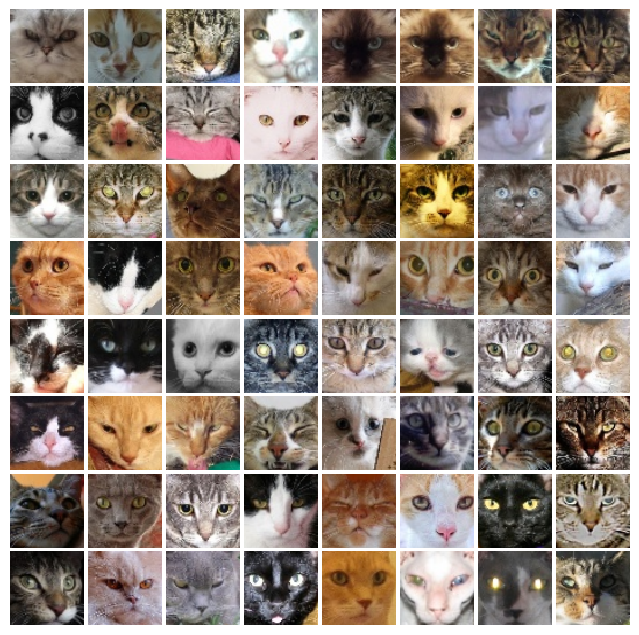

In [32]:
from gan.utils import show_images

try:
  imgs = next(iter(cat_loader_train))[0].numpy().squeeze()
except:
  imgs = cat_loader_train.__iter__().next()[0].numpy().squeeze()

show_images(imgs, color=True)

# Обучение

**TODO:** Допишите недостающие строки в цикле обучения в файле `gan/train.py`.

In [33]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

### Обучение GAN

In [34]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [35]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.497, G:13.64


/home/ilya/maga/DL/venv/lib/python3.11/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
/home/ilya/maga/DL/venv/lib/python3.11/site-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


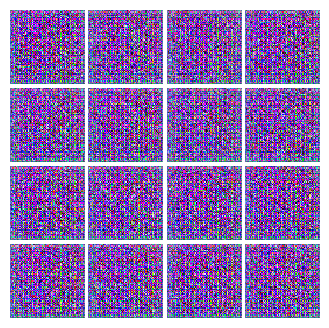


EPOCH:  2
Iter: 250, D: 0.7631, G:3.122


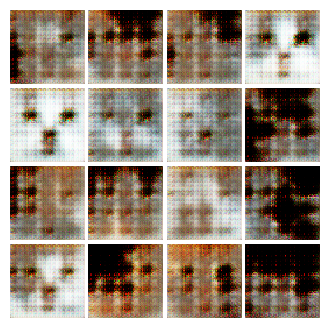


EPOCH:  3
Iter: 500, D: 0.8886, G:3.135


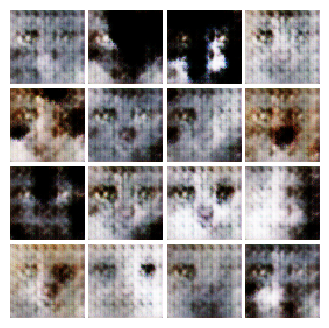


EPOCH:  4
Iter: 750, D: 0.7781, G:2.378


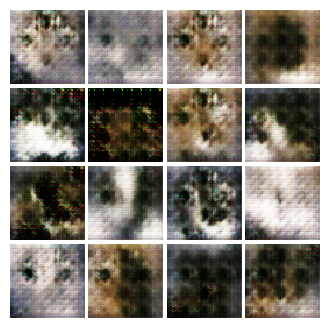


EPOCH:  5
Iter: 1000, D: 1.549, G:1.709


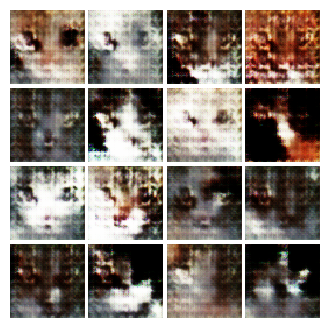


EPOCH:  6
Iter: 1250, D: 0.8446, G:2.481


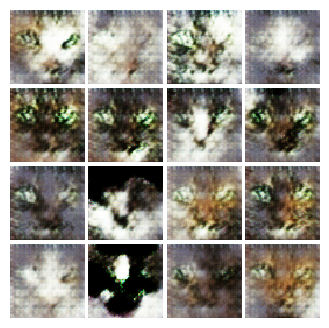


EPOCH:  7
Iter: 1500, D: 1.303, G:1.824


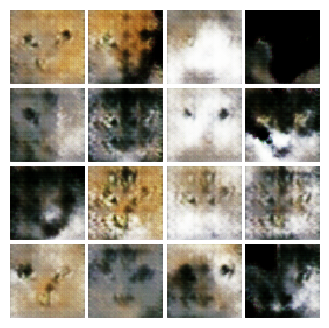


EPOCH:  8
Iter: 1750, D: 1.998, G:1.899


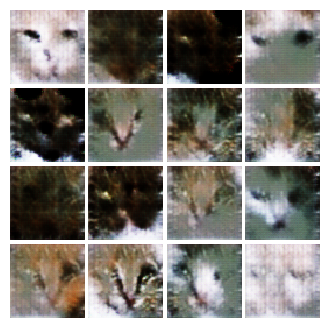


EPOCH:  9
Iter: 2000, D: 0.8579, G:3.39


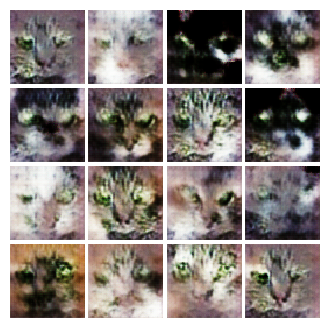


EPOCH:  10
Iter: 2250, D: 0.6835, G:1.707


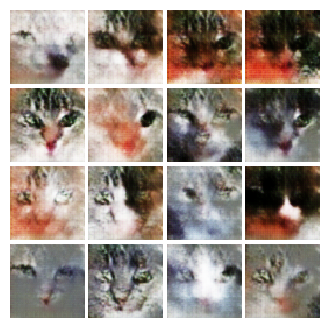


EPOCH:  11
Iter: 2500, D: 0.9366, G:5.551


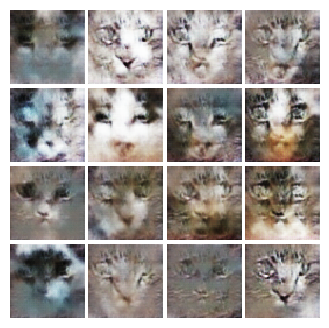


EPOCH:  12
Iter: 2750, D: 1.249, G:6.22


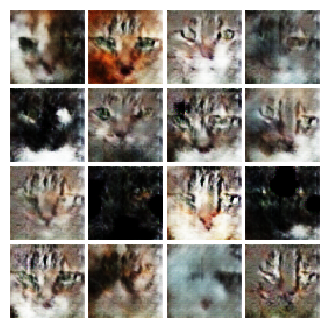


EPOCH:  13
Iter: 3000, D: 1.092, G:3.151


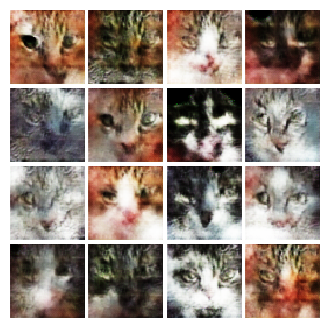


EPOCH:  14
Iter: 3250, D: 0.1703, G:4.803


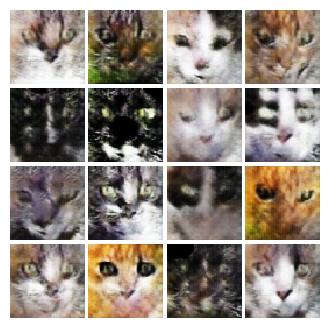


EPOCH:  15
Iter: 3500, D: 0.8494, G:8.051


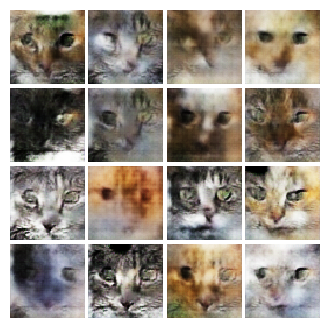


EPOCH:  16
Iter: 3750, D: 1.422, G:2.844


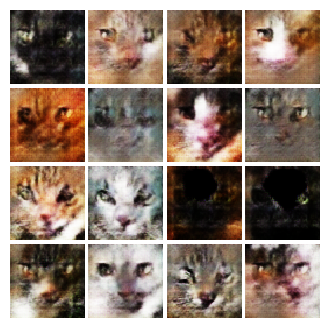


EPOCH:  17
Iter: 4000, D: 1.005, G:2.921


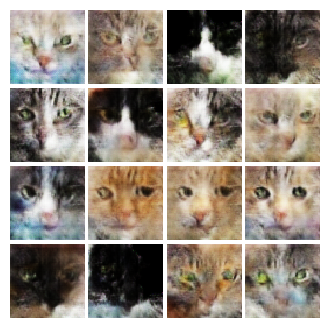


EPOCH:  18
Iter: 4250, D: 0.2567, G:5.072


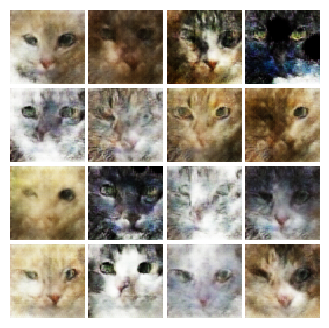


EPOCH:  19
Iter: 4500, D: 0.3447, G:6.128


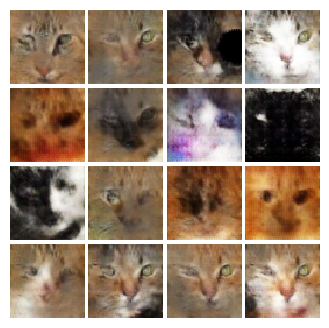


EPOCH:  20
Iter: 4750, D: 0.2631, G:6.973


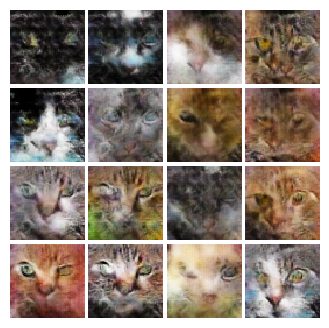


EPOCH:  21
Iter: 5000, D: 0.226, G:5.091


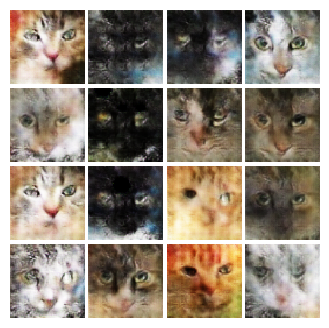


EPOCH:  22
Iter: 5250, D: 0.08195, G:5.742


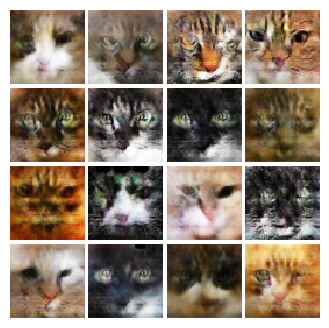


EPOCH:  23
Iter: 5500, D: 0.2414, G:4.585


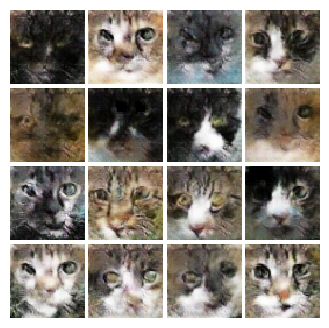


EPOCH:  24
Iter: 5750, D: 0.3125, G:9.676


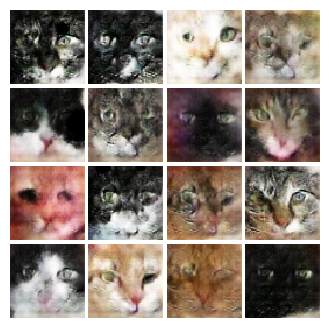


EPOCH:  25
Iter: 6000, D: 0.01065, G:7.258


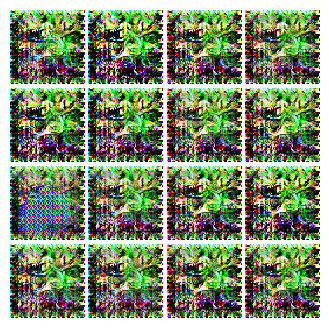


EPOCH:  26
Iter: 6250, D: 1.853e-05, G:13.43


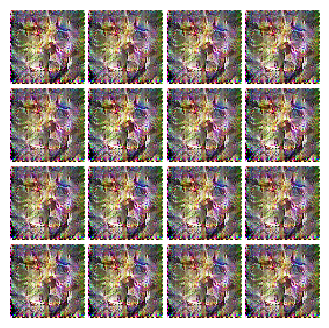


EPOCH:  27
Iter: 6500, D: 0.2459, G:3.807


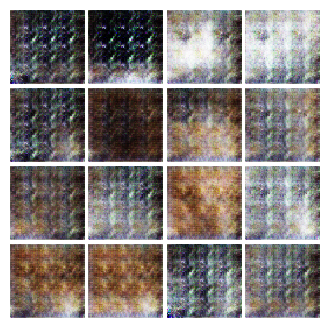


EPOCH:  28
Iter: 6750, D: 0.351, G:7.128


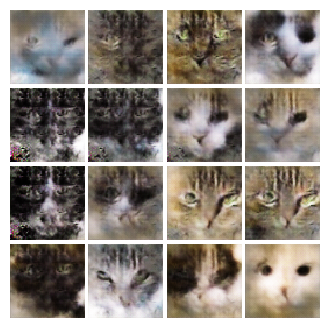


EPOCH:  29
Iter: 7000, D: 0.1671, G:6.225


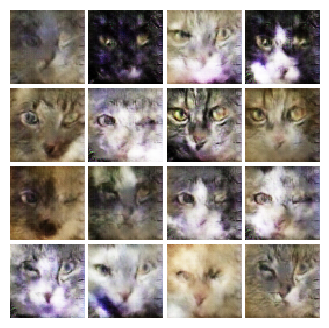


EPOCH:  30
Iter: 7250, D: 1.597, G:4.004


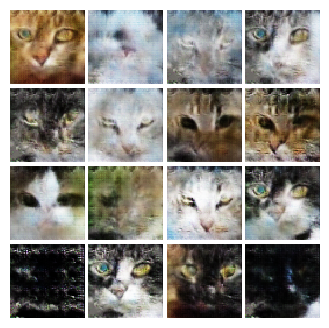


EPOCH:  31
Iter: 7500, D: 0.07057, G:4.771


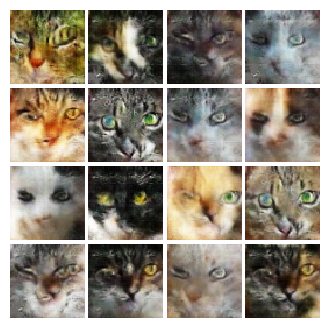


EPOCH:  32
Iter: 7750, D: 0.4707, G:9.402


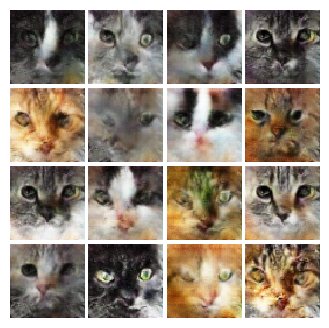


EPOCH:  33
Iter: 8000, D: 0.1124, G:15.03


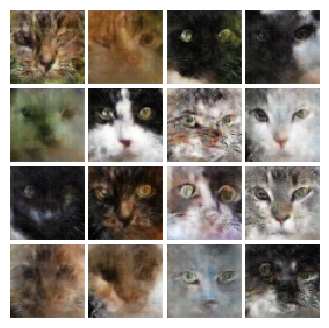


EPOCH:  34
Iter: 8250, D: 0.5924, G:12.17


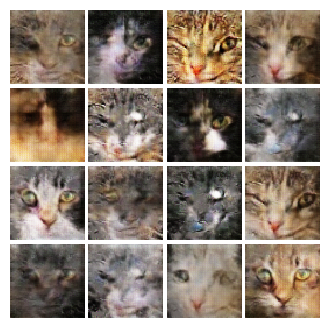


EPOCH:  35
Iter: 8500, D: 0.07982, G:10.07


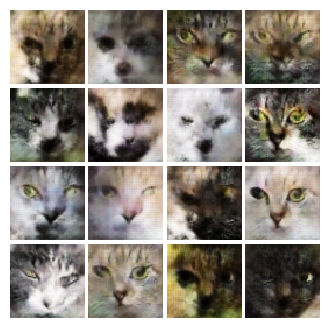


EPOCH:  36
Iter: 8750, D: 1.139, G:5.298


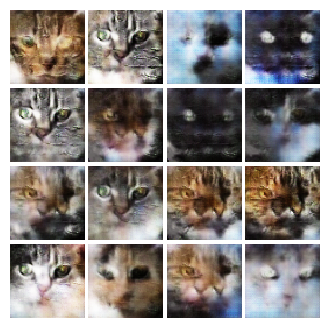


EPOCH:  37
Iter: 9000, D: 0.3031, G:9.558


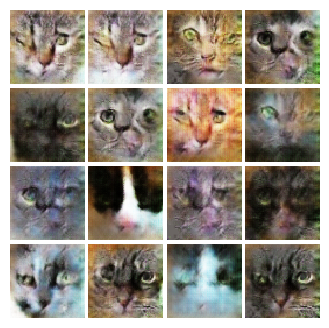


EPOCH:  38
Iter: 9250, D: 0.07605, G:9.457


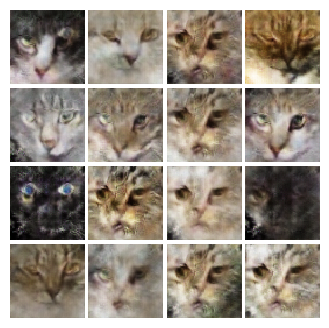


EPOCH:  39
Iter: 9500, D: 0.03639, G:6.38


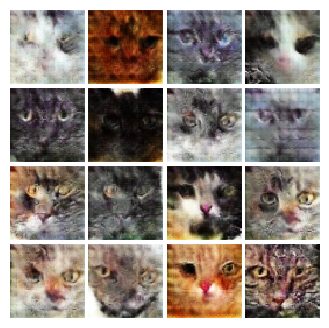


EPOCH:  40
Iter: 9750, D: 0.1051, G:5.024


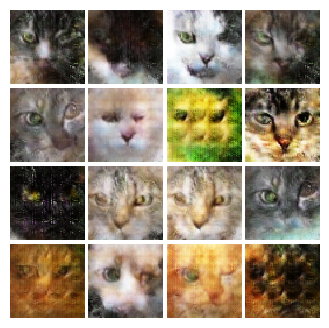


EPOCH:  41
Iter: 10000, D: 0.08953, G:7.618


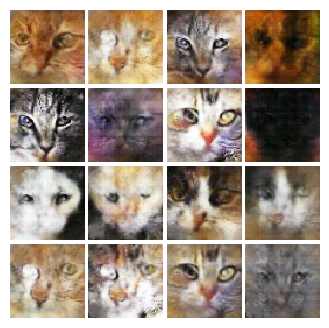


EPOCH:  42
Iter: 10250, D: 0.01883, G:8.212


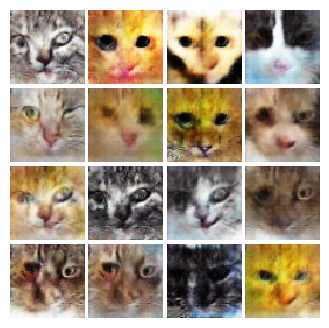


EPOCH:  43
Iter: 10500, D: 0.07442, G:6.996


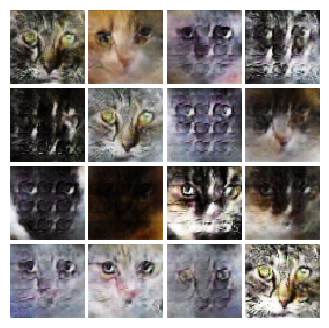


EPOCH:  44
Iter: 10750, D: 0.3463, G:15.42


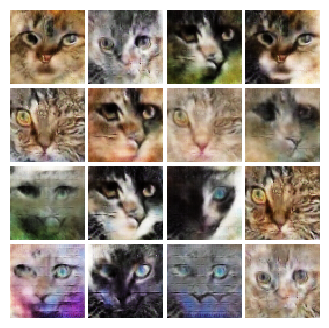


EPOCH:  45
Iter: 11000, D: 0.1571, G:10.21


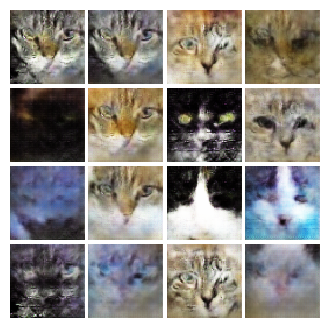


EPOCH:  46
Iter: 11250, D: 0.05799, G:7.385


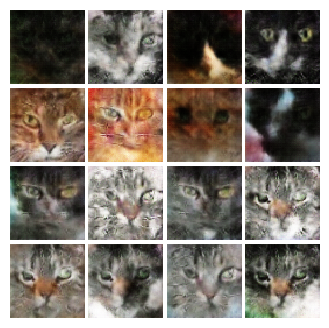


EPOCH:  47
Iter: 11500, D: 0.1776, G:9.278


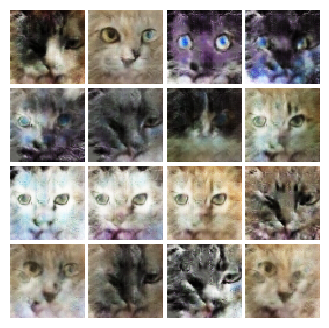


EPOCH:  48
Iter: 11750, D: 0.09793, G:6.838


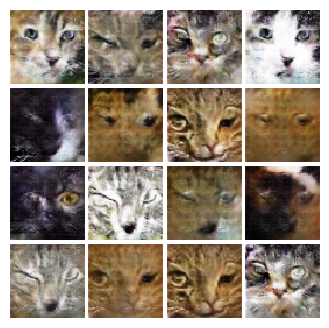


EPOCH:  49
Iter: 12000, D: 0.05076, G:7.106


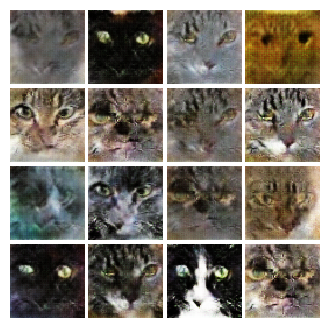


EPOCH:  50
Iter: 12250, D: 0.04546, G:6.209


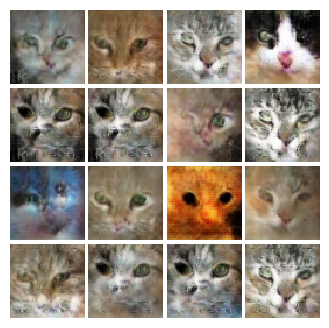

In [36]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)


### Обучение LS-GAN

In [37]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [38]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.6147, G:338.2


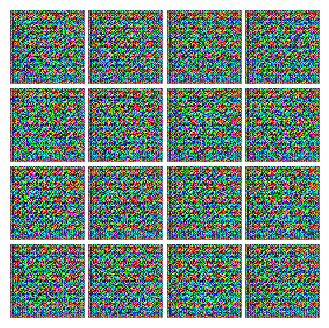


EPOCH:  2
Iter: 250, D: 0.08963, G:0.8083


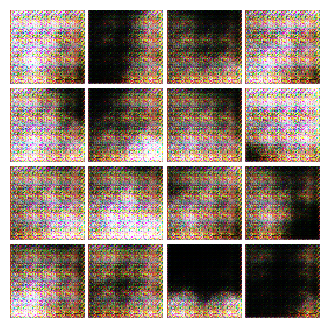


EPOCH:  3
Iter: 500, D: 0.1905, G:1.119


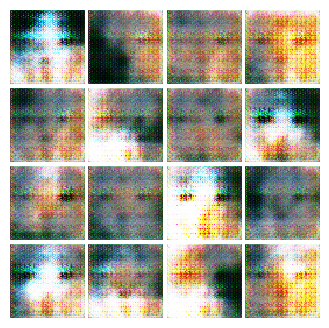


EPOCH:  4
Iter: 750, D: 0.3911, G:2.625


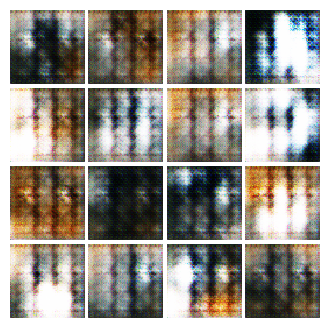


EPOCH:  5
Iter: 1000, D: 0.8485, G:1.089


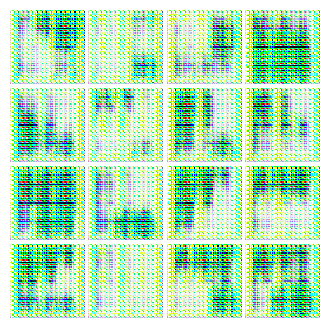


EPOCH:  6
Iter: 1250, D: 0.03972, G:1.015


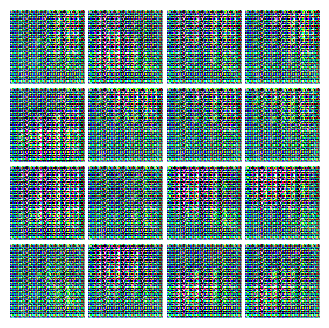


EPOCH:  7
Iter: 1500, D: 0.2205, G:0.4991


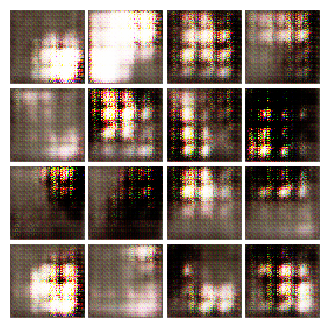


EPOCH:  8
Iter: 1750, D: 0.1531, G:0.3354


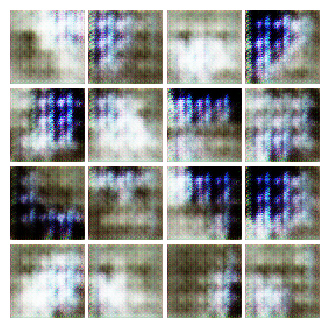


EPOCH:  9
Iter: 2000, D: 0.1473, G:0.6619


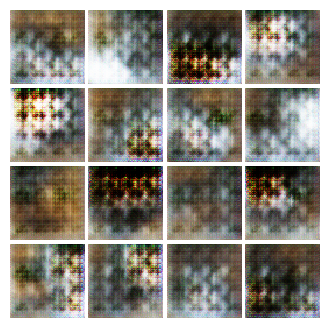


EPOCH:  10
Iter: 2250, D: 0.06319, G:0.7116


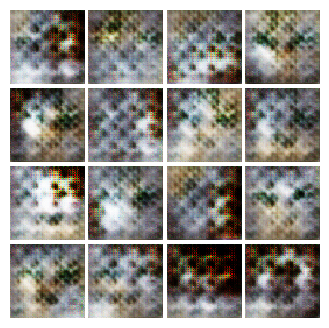


EPOCH:  11
Iter: 2500, D: 0.3784, G:1.277


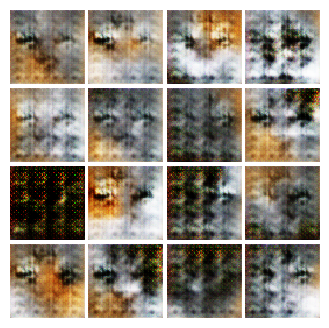


EPOCH:  12
Iter: 2750, D: 16.25, G:9.958


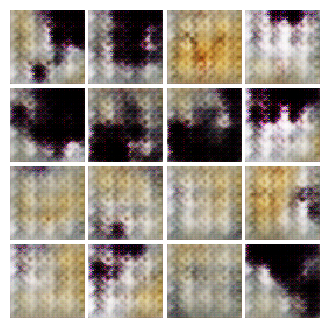


EPOCH:  13
Iter: 3000, D: 0.1672, G:0.7166


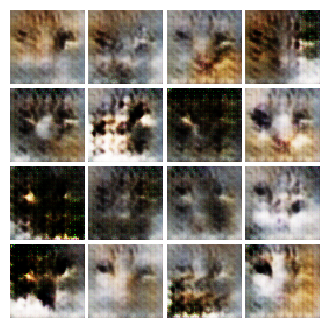


EPOCH:  14
Iter: 3250, D: 0.1864, G:0.6622


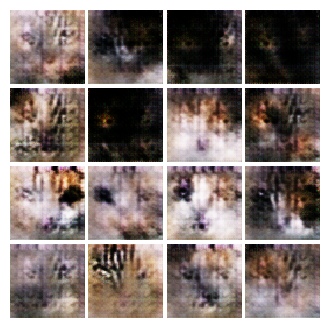


EPOCH:  15
Iter: 3500, D: 0.5005, G:0.7659


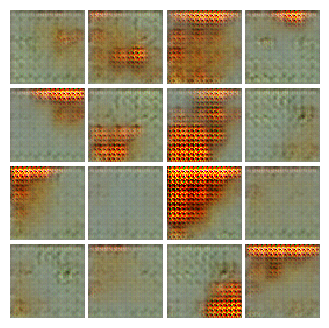


EPOCH:  16
Iter: 3750, D: 0.4885, G:1.472


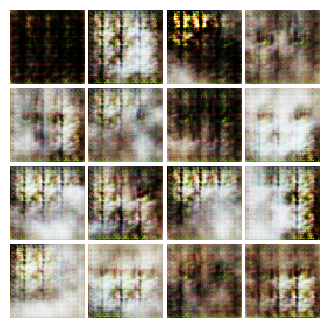


EPOCH:  17
Iter: 4000, D: 0.2891, G:0.4976


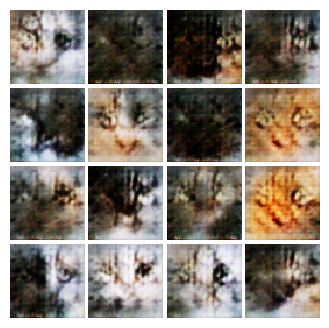


EPOCH:  18
Iter: 4250, D: 0.2216, G:0.4677


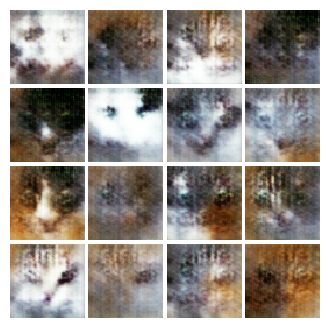


EPOCH:  19
Iter: 4500, D: 0.2113, G:0.6039


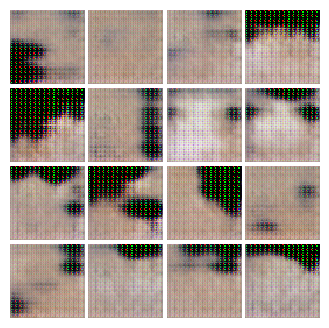


EPOCH:  20
Iter: 4750, D: 1.587, G:0.8855


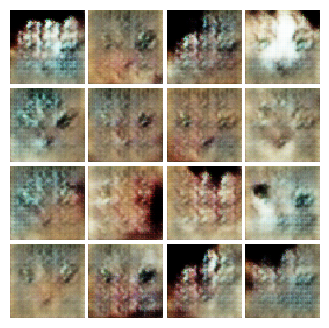


EPOCH:  21
Iter: 5000, D: 0.1693, G:0.5741


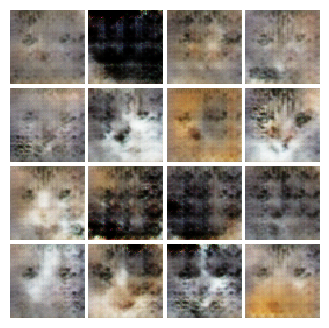


EPOCH:  22
Iter: 5250, D: 0.347, G:0.621


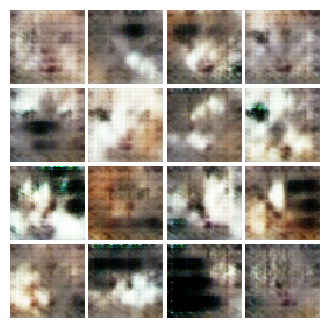


EPOCH:  23
Iter: 5500, D: 0.2137, G:0.724


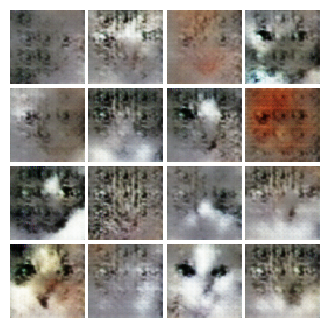


EPOCH:  24
Iter: 5750, D: 0.1291, G:0.9102


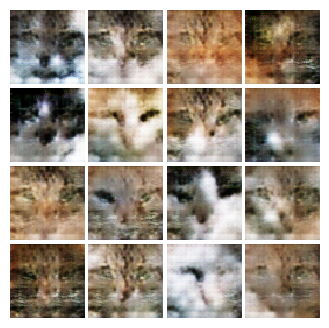


EPOCH:  25
Iter: 6000, D: 0.1138, G:0.9185


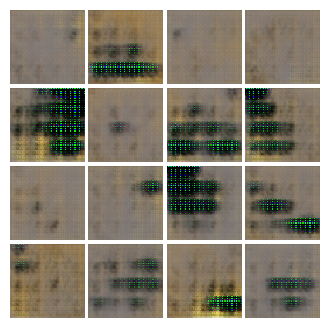


EPOCH:  26
Iter: 6250, D: 0.3528, G:1.937


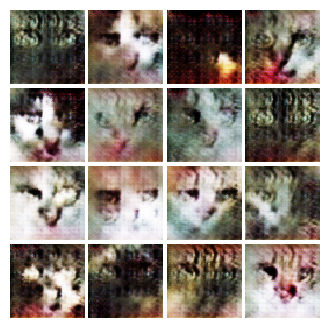


EPOCH:  27
Iter: 6500, D: 0.3087, G:0.6642


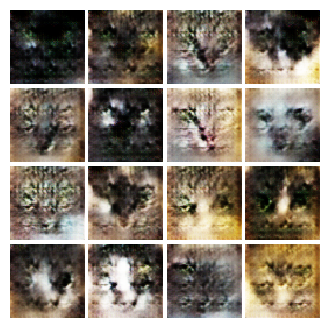


EPOCH:  28
Iter: 6750, D: 0.1926, G:0.5119


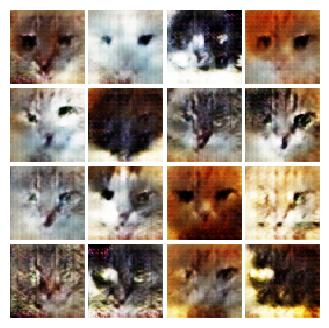


EPOCH:  29
Iter: 7000, D: 0.2501, G:0.7001


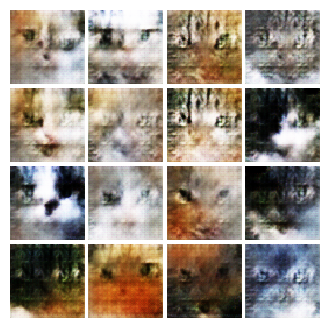


EPOCH:  30
Iter: 7250, D: 0.3154, G:1.042


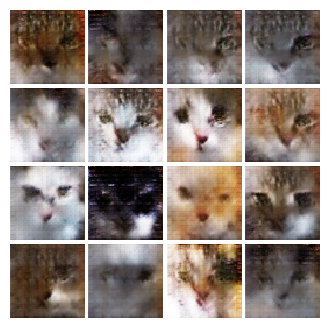


EPOCH:  31
Iter: 7500, D: 0.2314, G:0.6324


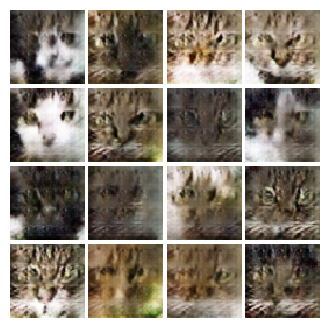


EPOCH:  32
Iter: 7750, D: 0.1696, G:0.8365


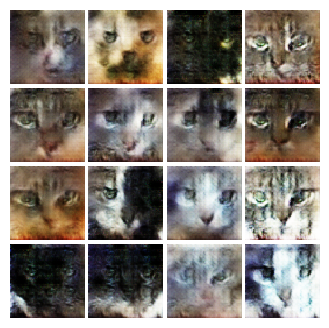


EPOCH:  33
Iter: 8000, D: 0.212, G:0.8395


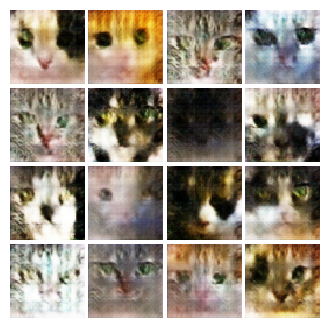


EPOCH:  34
Iter: 8250, D: 0.21, G:0.5693


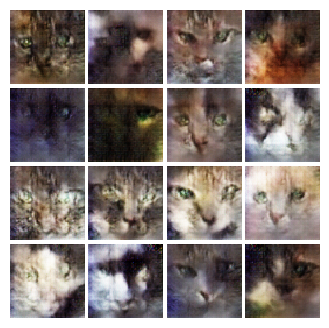


EPOCH:  35
Iter: 8500, D: 0.3343, G:0.4764


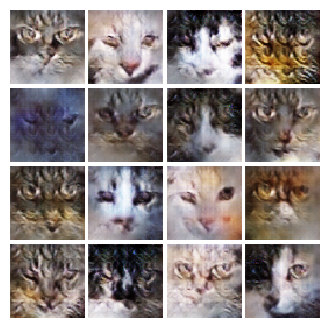


EPOCH:  36
Iter: 8750, D: 0.3682, G:0.3355


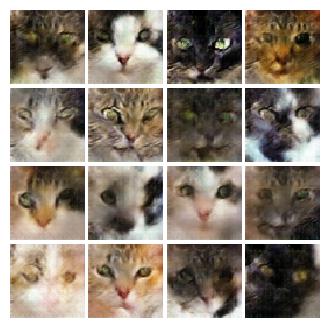


EPOCH:  37
Iter: 9000, D: 0.1306, G:0.741


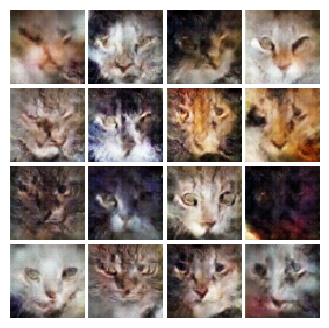


EPOCH:  38
Iter: 9250, D: 0.2291, G:1.046


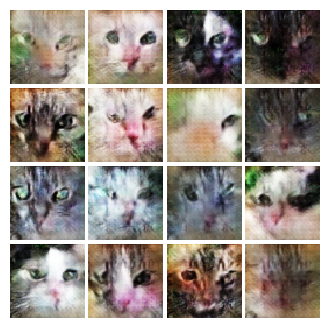


EPOCH:  39
Iter: 9500, D: 0.2249, G:0.691


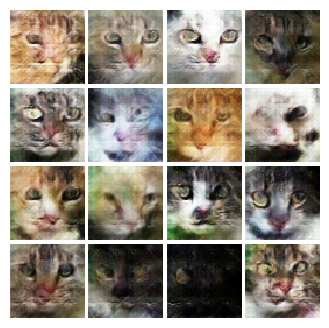


EPOCH:  40
Iter: 9750, D: 0.3074, G:0.7795


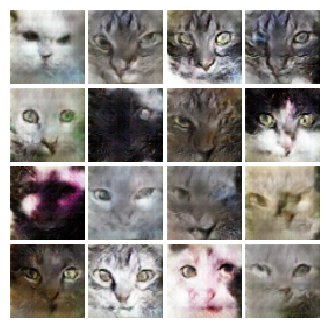


EPOCH:  41
Iter: 10000, D: 0.2675, G:0.6628


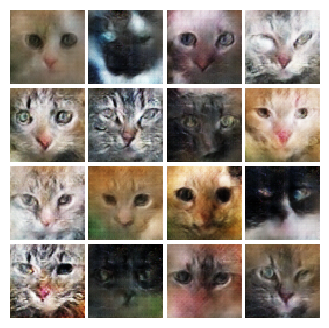


EPOCH:  42
Iter: 10250, D: 0.2548, G:1.329


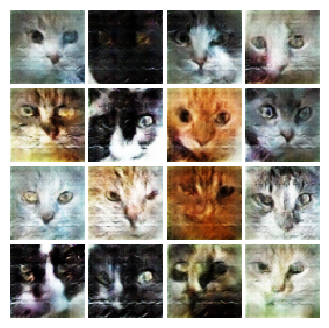


EPOCH:  43
Iter: 10500, D: 0.2183, G:0.3267


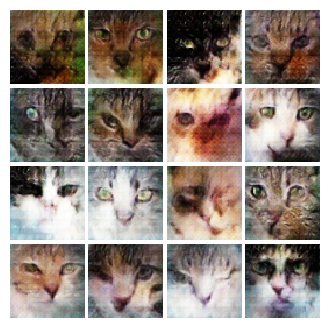


EPOCH:  44
Iter: 10750, D: 0.2722, G:0.491


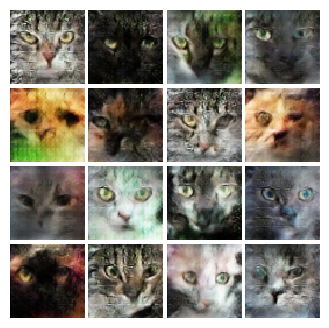


EPOCH:  45
Iter: 11000, D: 0.128, G:0.8091


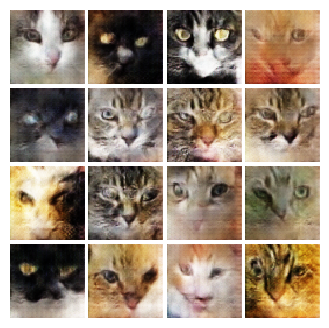


EPOCH:  46
Iter: 11250, D: 0.1952, G:0.6582


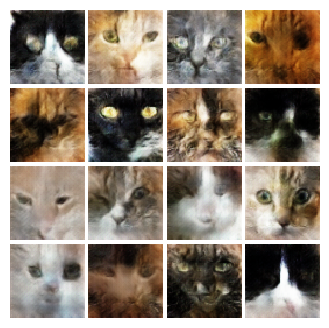


EPOCH:  47
Iter: 11500, D: 0.2489, G:0.4182


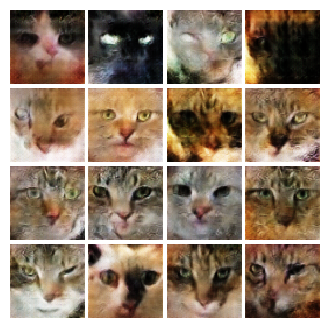


EPOCH:  48
Iter: 11750, D: 0.2534, G:0.3328


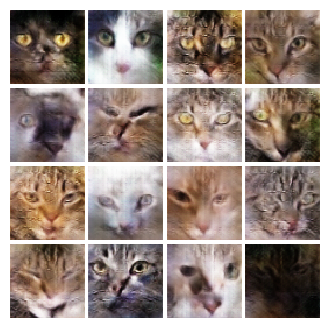


EPOCH:  49
Iter: 12000, D: 0.2839, G:0.3418


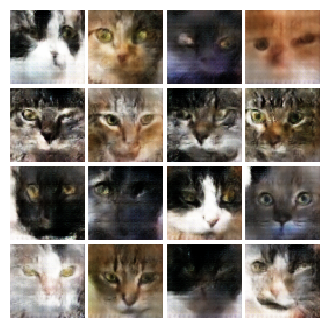


EPOCH:  50
Iter: 12250, D: 0.2723, G:0.2794


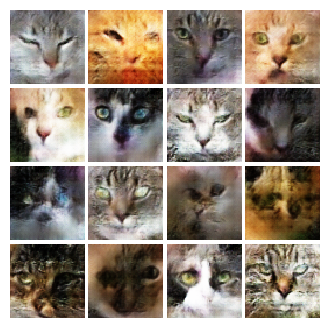

In [39]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss,
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

# Medmnist

In [40]:
import medmnist
from medmnist import ChestMNIST

In [67]:
batch_size = 64
imsize = 64

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(int(1.15 * imsize)),
    transforms.RandomCrop(imsize),
])

In [69]:
train_dataset = ChestMNIST(split="train", download=True, transform=transform)
loader_train = DataLoader(train_dataset, batch_size=batch_size, drop_last=True)

test_dataset = ChestMNIST(split="test", download=True, transform=transform)
loader_test = DataLoader(test_dataset, batch_size=batch_size, drop_last=True)

Using downloaded and verified file: /home/ilya/.medmnist/chestmnist.npz
Using downloaded and verified file: /home/ilya/.medmnist/chestmnist.npz


In [70]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

In [79]:
D = Discriminator(input_channels=1).to(device)
G = Generator(noise_dim=NOISE_DIM, output_channels=1).to(device)
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.647, G:13.78


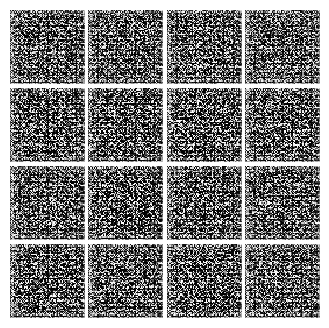


Iter: 250, D: 0.4306, G:3.97


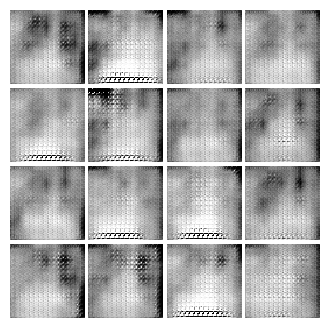


Iter: 500, D: 0.6814, G:2.826


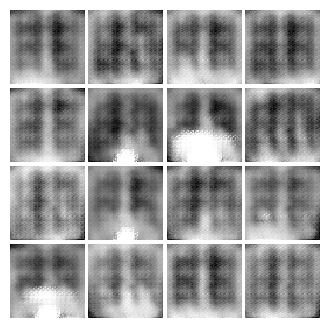


Iter: 750, D: 0.05709, G:3.497


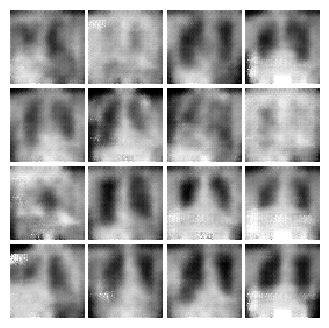


Iter: 1000, D: 0.01771, G:5.838


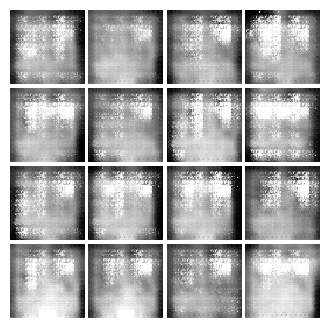


EPOCH:  2
Iter: 1250, D: 0.4907, G:0.4988


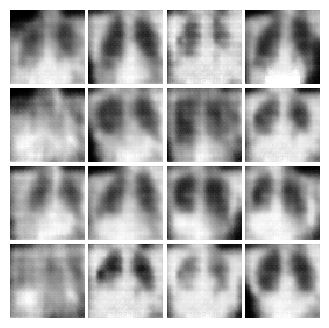


Iter: 1500, D: 0.08672, G:2.958


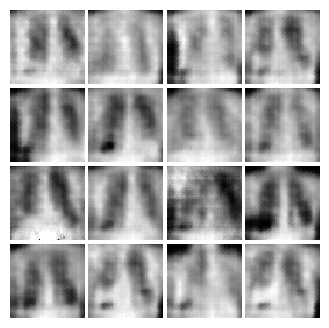


Iter: 1750, D: 1.255, G:2.177


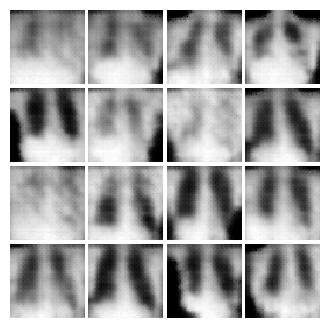


Iter: 2000, D: 1.312, G:1.08


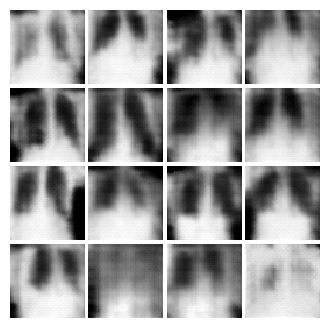


Iter: 2250, D: 1.185, G:1.716


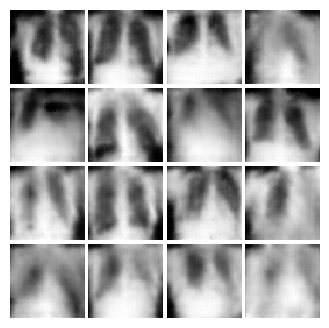


EPOCH:  3
Iter: 2500, D: 1.064, G:1.716


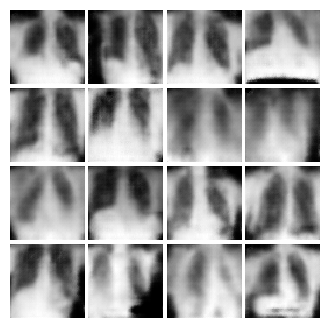


Iter: 2750, D: 1.07, G:2.634


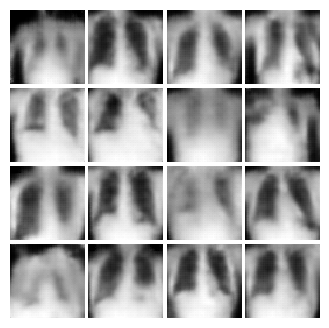


Iter: 3000, D: 1.425, G:1.575


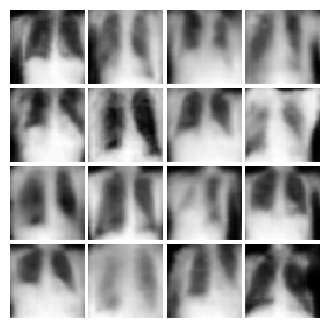


Iter: 3250, D: 3.308, G:3.403


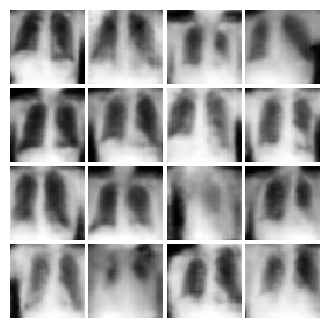


Iter: 3500, D: 1.544, G:0.8453


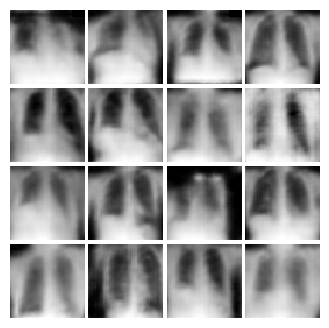


EPOCH:  4
Iter: 3750, D: 1.269, G:1.522


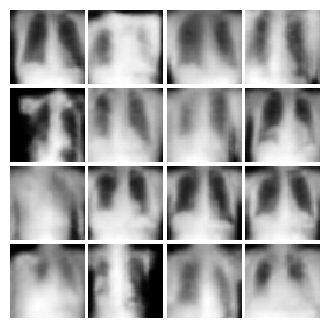


Iter: 4000, D: 1.186, G:1.309


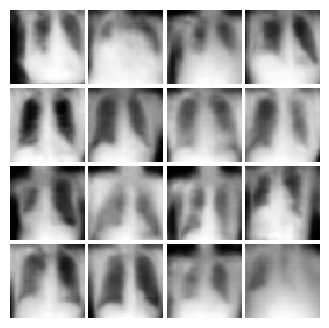


Iter: 4250, D: 1.183, G:0.6962


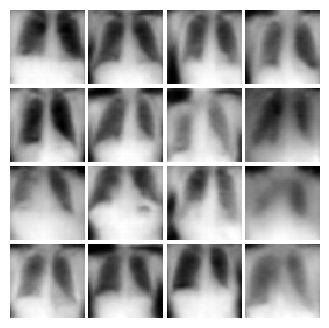


Iter: 4500, D: 0.952, G:1.973


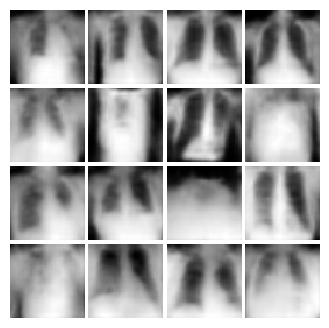


Iter: 4750, D: 0.8865, G:1.481


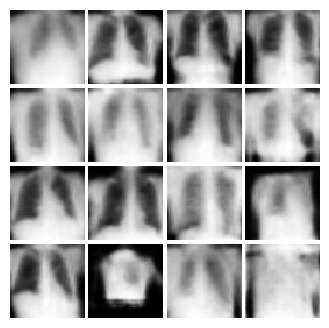


EPOCH:  5
Iter: 5000, D: 1.154, G:2.658


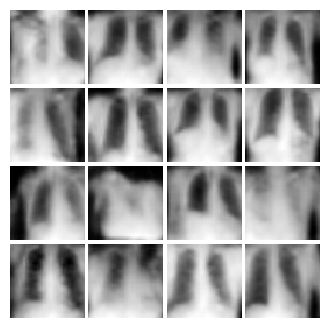


Iter: 5250, D: 0.9999, G:2.133


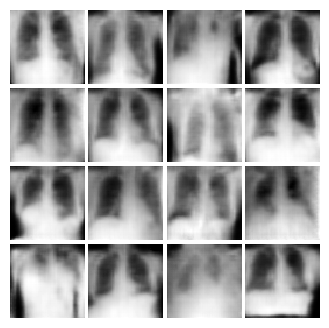


Iter: 5500, D: 0.8508, G:2.519


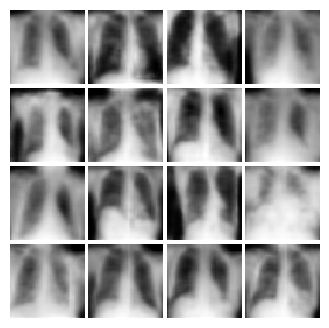


Iter: 5750, D: 2.345, G:0.6592


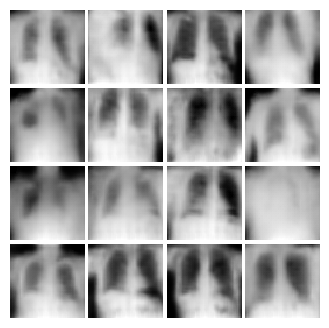


Iter: 6000, D: 0.7074, G:2.095


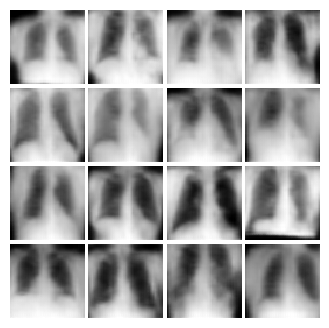


EPOCH:  6
Iter: 6250, D: 0.4813, G:3.004


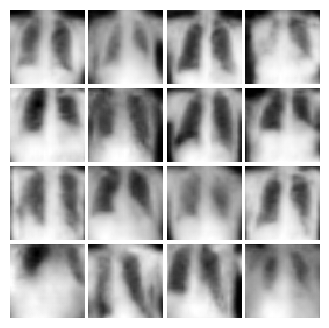


Iter: 6500, D: 0.5007, G:2.616


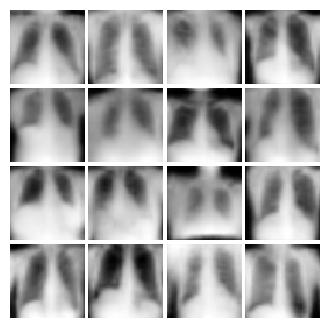


Iter: 6750, D: 0.826, G:2.303


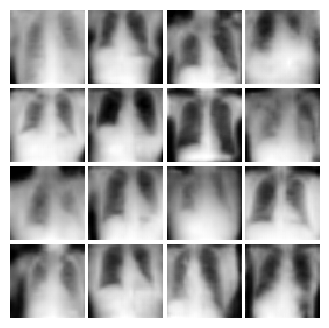


Iter: 7000, D: 0.7994, G:1.684


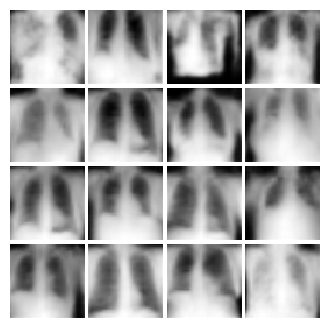


Iter: 7250, D: 0.8507, G:3.342


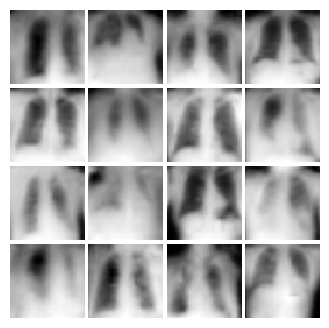


EPOCH:  7
Iter: 7500, D: 0.8977, G:1.516


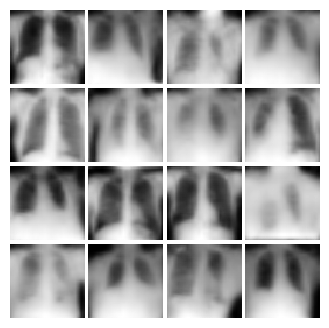


Iter: 7750, D: 1.012, G:3.27


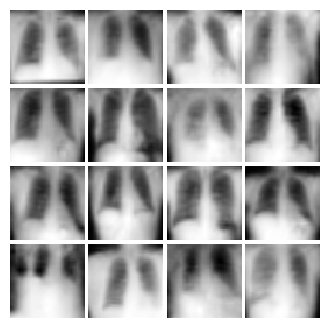


Iter: 8000, D: 0.9299, G:1.21


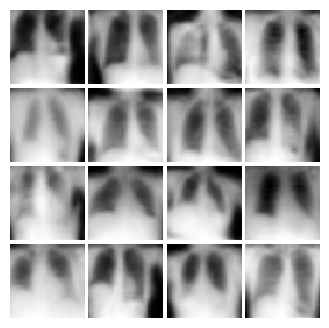


Iter: 8250, D: 0.4281, G:2.335


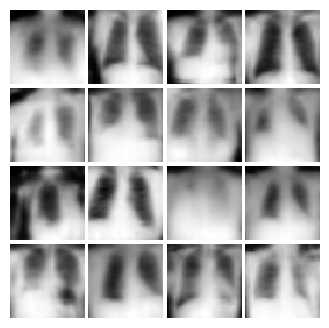


Iter: 8500, D: 0.2886, G:3.564


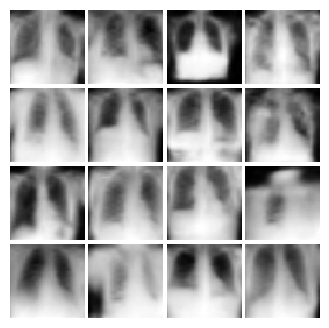


EPOCH:  8
Iter: 8750, D: 0.4523, G:3.634


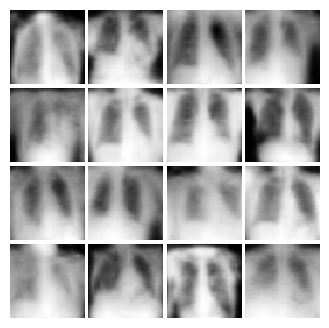


Iter: 9000, D: 0.1294, G:4.279


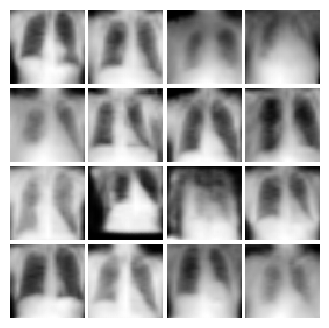


Iter: 9250, D: 0.8502, G:5.012


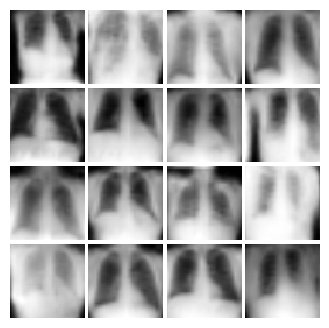


Iter: 9500, D: 1.035, G:1.491


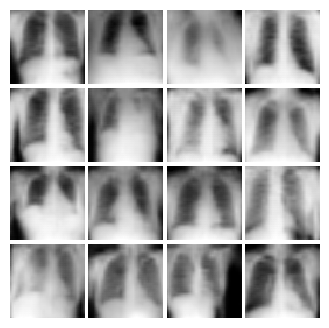


Iter: 9750, D: 0.7482, G:1.902


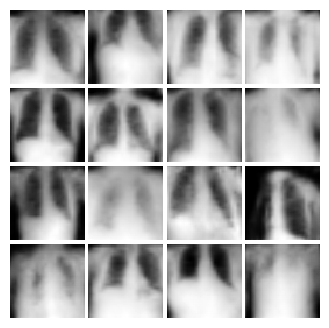


EPOCH:  9
Iter: 10000, D: 0.473, G:2.798


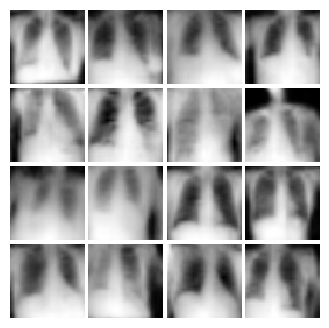


Iter: 10250, D: 0.5738, G:2.275


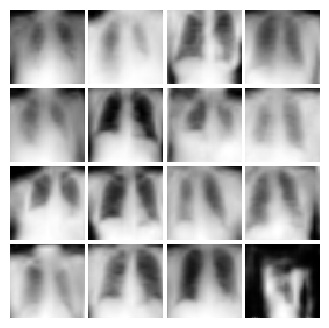


Iter: 10500, D: 0.4901, G:3.546


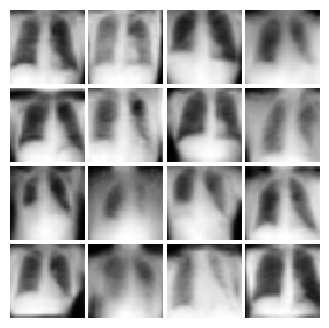


Iter: 10750, D: 0.2828, G:2.479


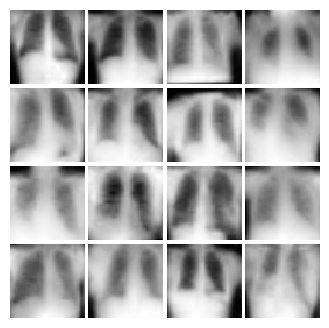


Iter: 11000, D: 0.04412, G:3.489


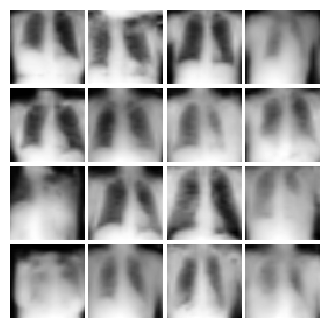


EPOCH:  10
Iter: 11250, D: 1.028, G:1.055


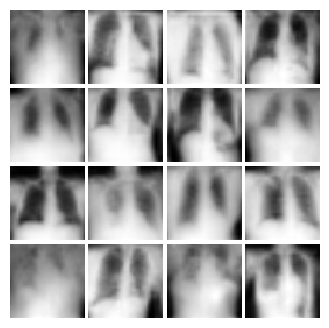


Iter: 11500, D: 0.8424, G:6.146


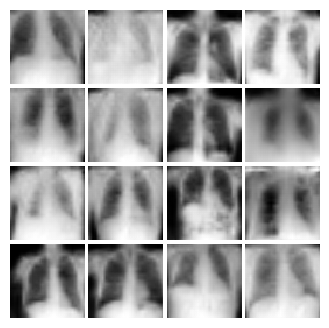


Iter: 11750, D: 0.2449, G:3.205


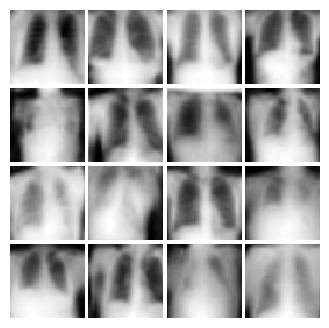


Iter: 12000, D: 0.9022, G:1.92


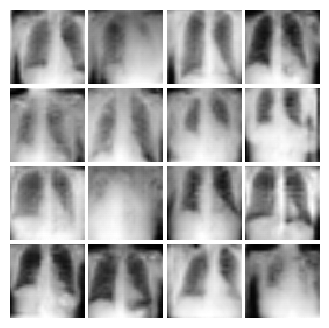


Iter: 12250, D: 0.9709, G:7.462


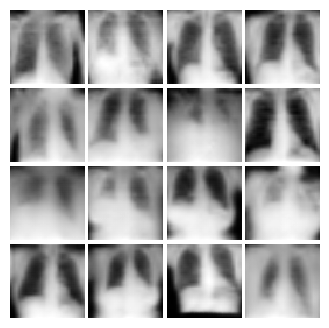


EPOCH:  11
Iter: 12500, D: 0.2168, G:4.771


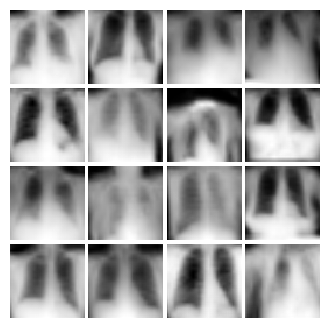


Iter: 12750, D: 0.923, G:1.399


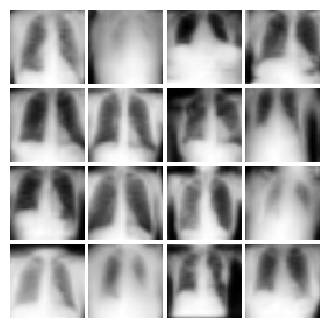


Iter: 13000, D: 0.419, G:3.694


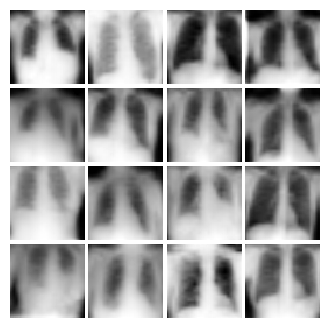


Iter: 13250, D: 0.3896, G:2.942


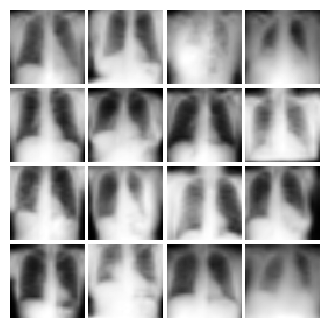


EPOCH:  12
Iter: 13500, D: 0.7849, G:2.0


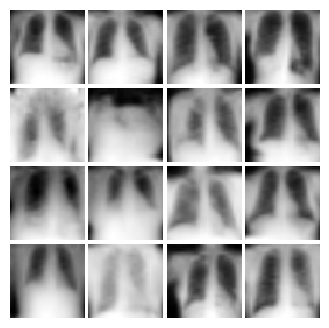


Iter: 13750, D: 0.8894, G:3.083


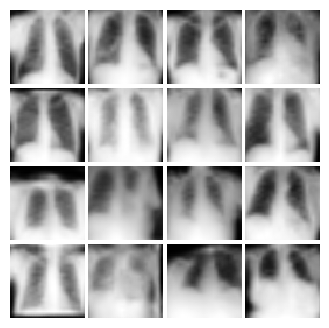


Iter: 14000, D: 0.7022, G:1.264


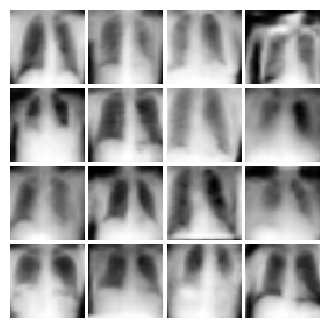


Iter: 14250, D: 0.4147, G:4.341


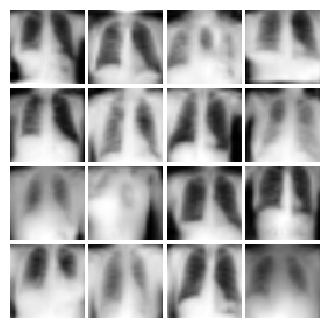


Iter: 14500, D: 0.3757, G:4.071


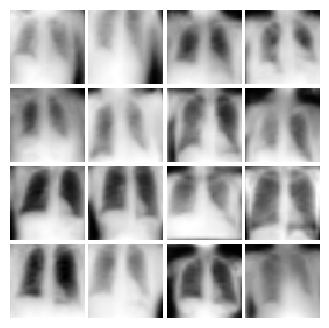


EPOCH:  13
Iter: 14750, D: 0.3206, G:1.671


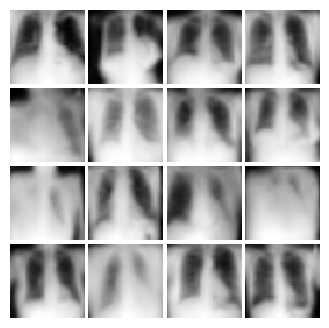


Iter: 15000, D: 0.8404, G:5.045


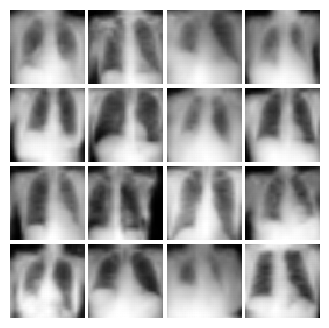


Iter: 15250, D: 0.4398, G:3.203


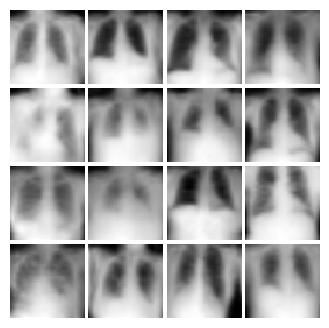


Iter: 15500, D: 0.455, G:4.226


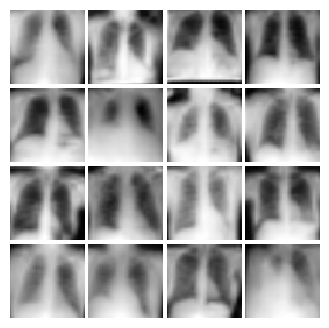


Iter: 15750, D: 0.2624, G:4.054


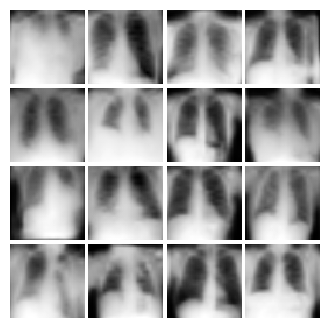


EPOCH:  14
Iter: 16000, D: 1.323, G:1.06


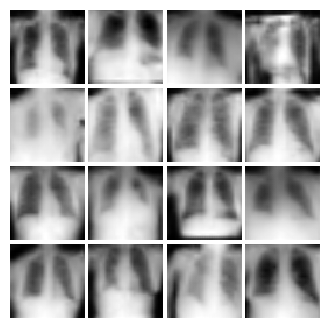


Iter: 16250, D: 0.1778, G:2.635


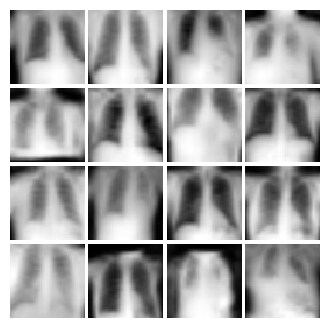


Iter: 16500, D: 0.3739, G:3.817


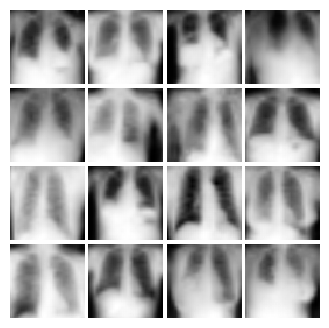


Iter: 16750, D: 0.8275, G:2.016


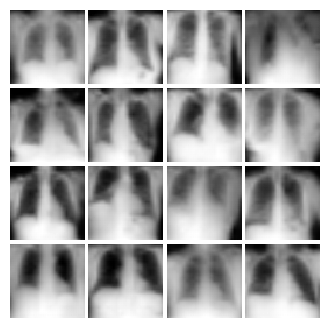


Iter: 17000, D: 0.1038, G:2.199


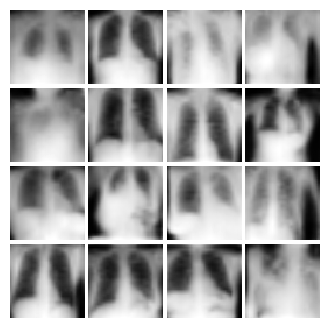


EPOCH:  15
Iter: 17250, D: 0.3663, G:5.445


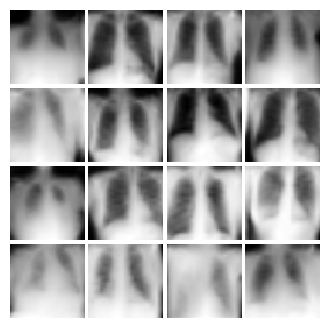


Iter: 17500, D: 0.2894, G:2.534


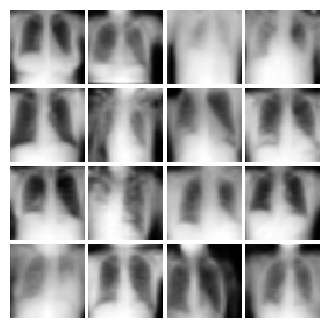


Iter: 17750, D: 0.3486, G:3.808


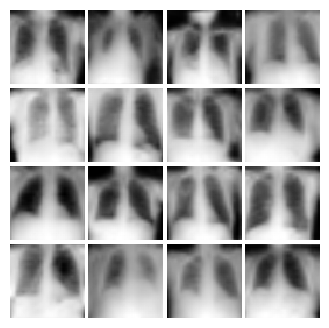


Iter: 18000, D: 0.7902, G:1.64


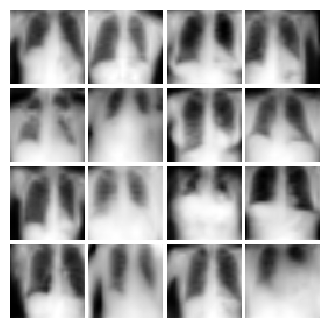


Iter: 18250, D: 0.2399, G:4.638


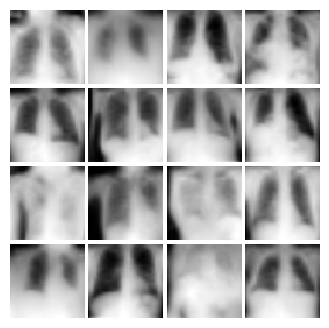


EPOCH:  16
Iter: 18500, D: 0.987, G:0.5281


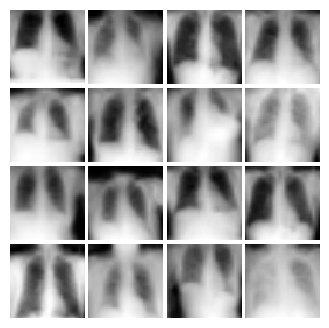


Iter: 18750, D: 1.629, G:1.036


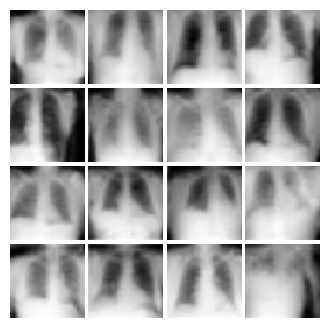


Iter: 19000, D: 0.9355, G:2.798


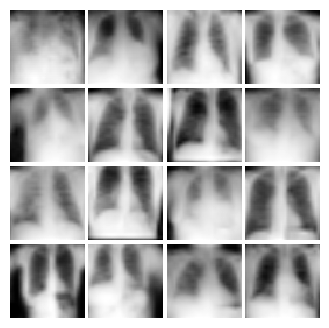


Iter: 19250, D: 0.1315, G:2.727


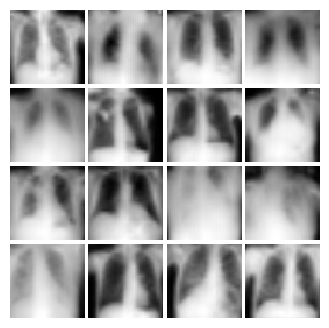


Iter: 19500, D: 0.6251, G:2.806


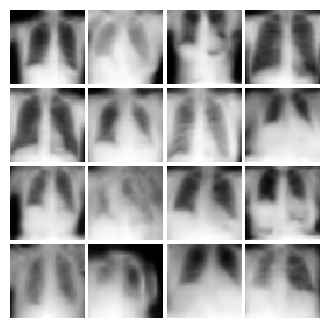


EPOCH:  17
Iter: 19750, D: 0.1721, G:3.969


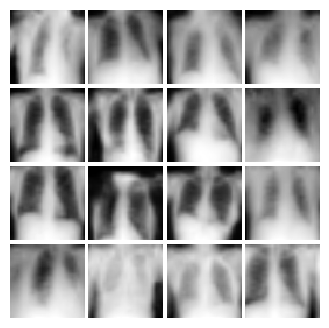


Iter: 20000, D: 0.4263, G:2.744


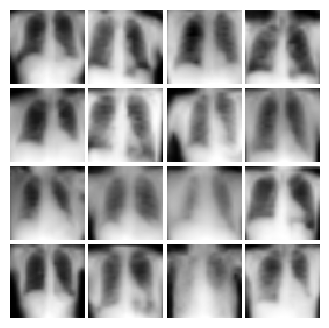


Iter: 20250, D: 0.2406, G:5.076


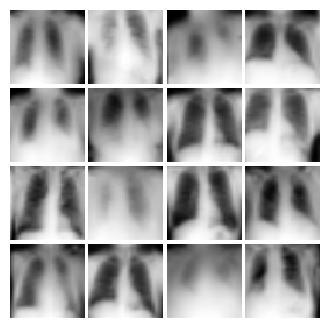


Iter: 20500, D: 0.5056, G:4.581


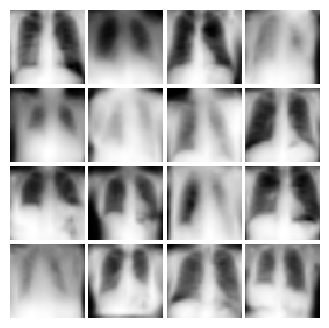


Iter: 20750, D: 0.4051, G:4.212


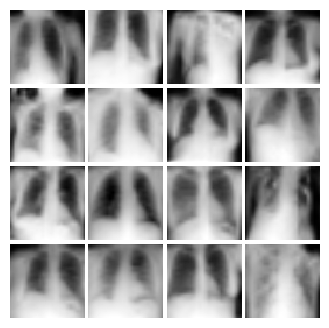


EPOCH:  18
Iter: 21000, D: 0.4166, G:4.554


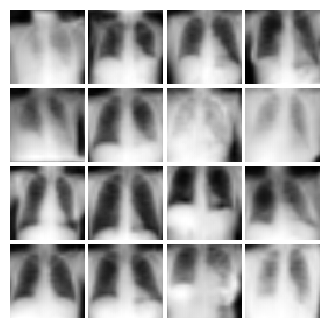


Iter: 21250, D: 0.696, G:2.86


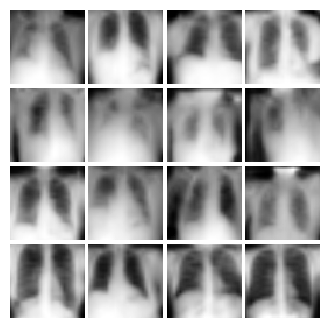


Iter: 21500, D: 0.9231, G:4.828


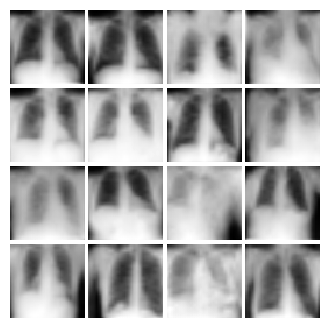


Iter: 21750, D: 0.8272, G:1.511


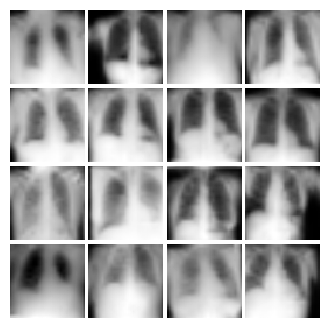


Iter: 22000, D: 0.3683, G:4.033


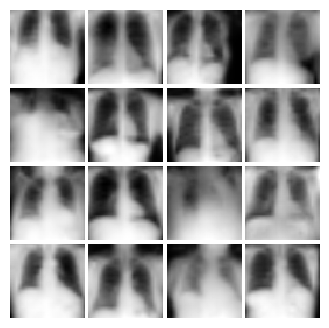


EPOCH:  19
Iter: 22250, D: 1.279, G:1.274


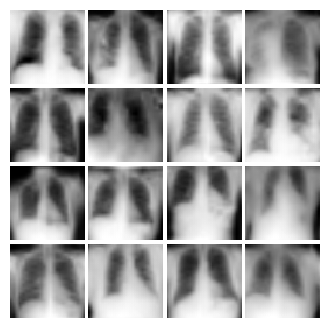


Iter: 22500, D: 0.5891, G:3.503


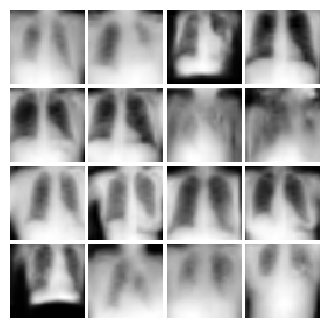


Iter: 22750, D: 0.4563, G:3.415


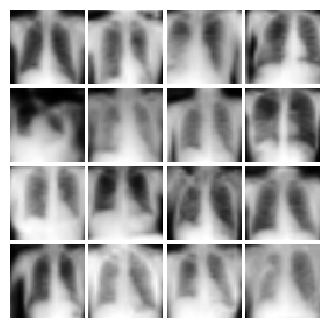


Iter: 23000, D: 0.1772, G:2.794


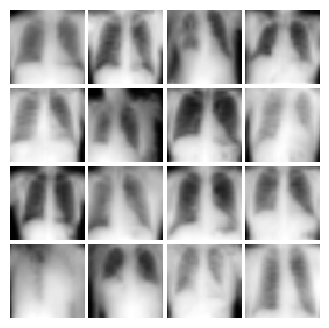


Iter: 23250, D: 1.616, G:1.493


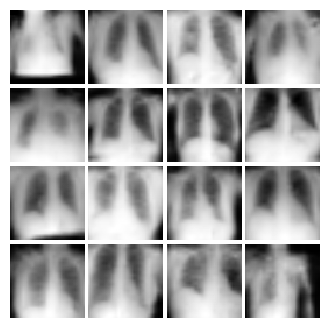


EPOCH:  20
Iter: 23500, D: 0.1585, G:4.905


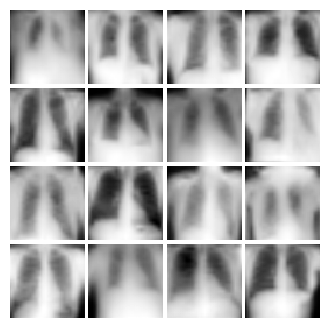


Iter: 23750, D: 0.2648, G:5.325


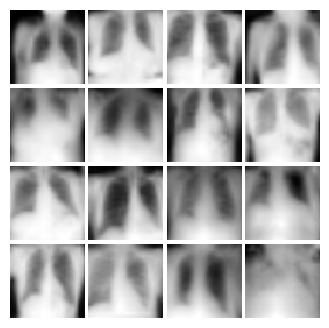


Iter: 24000, D: 0.2771, G:3.357


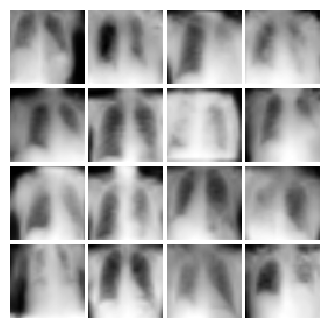


Iter: 24250, D: 0.4126, G:4.937


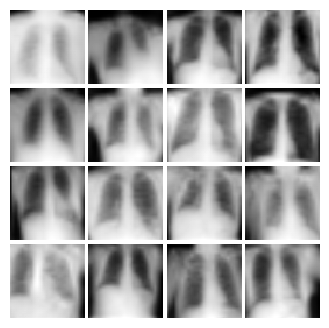


Iter: 24500, D: 0.2631, G:1.913


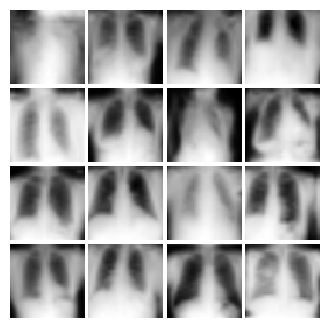


EPOCH:  21
Iter: 24750, D: 0.8642, G:2.331


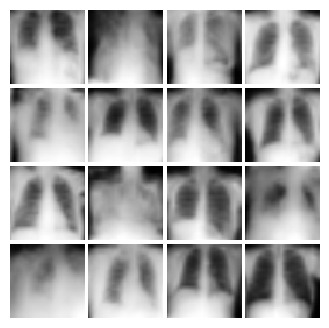


Iter: 25000, D: 0.05425, G:5.072


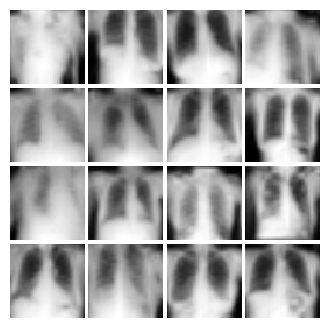


Iter: 25250, D: 0.5672, G:4.852


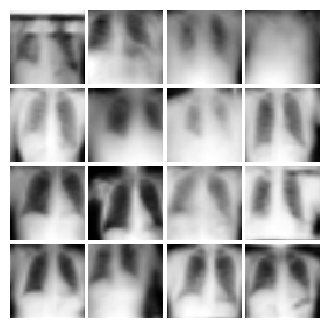


Iter: 25500, D: 0.3923, G:2.549


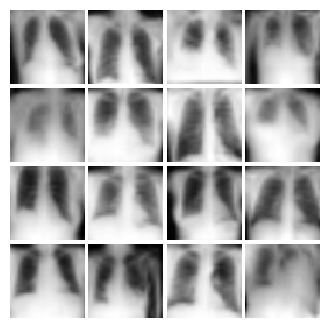


EPOCH:  22
Iter: 25750, D: 0.08138, G:2.698


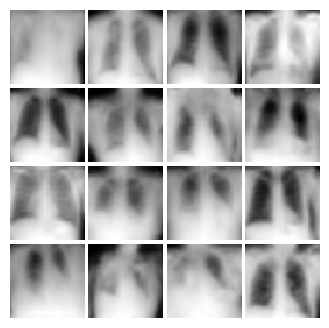


Iter: 26000, D: 0.3378, G:6.287


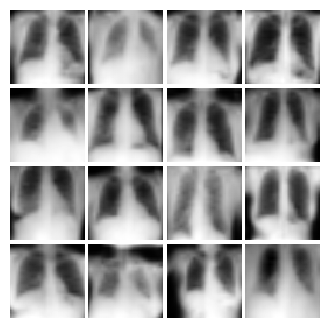


Iter: 26250, D: 0.1832, G:4.969


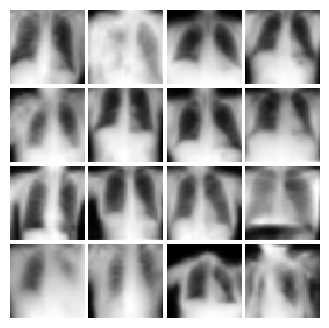


Iter: 26500, D: 0.5416, G:5.153


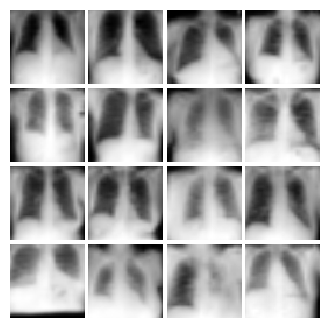


Iter: 26750, D: 0.4926, G:2.037


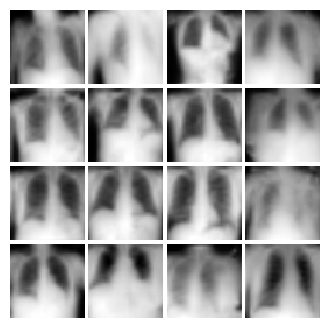


EPOCH:  23
Iter: 27000, D: 0.1033, G:4.495


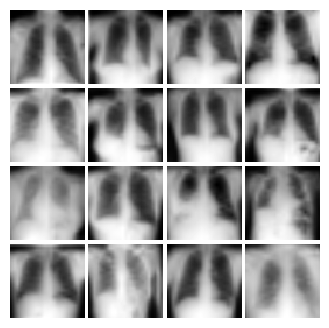


Iter: 27250, D: 0.206, G:5.695


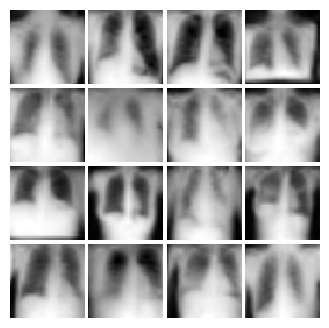


Iter: 27500, D: 0.8568, G:1.465


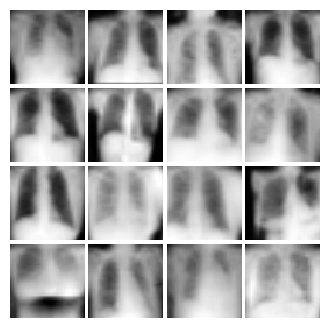


Iter: 27750, D: 1.978, G:0.6646


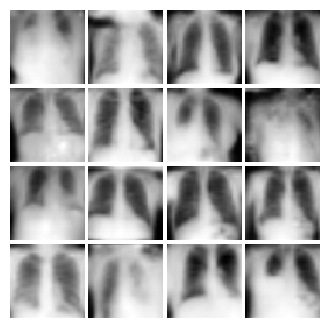


Iter: 28000, D: 0.8655, G:2.659


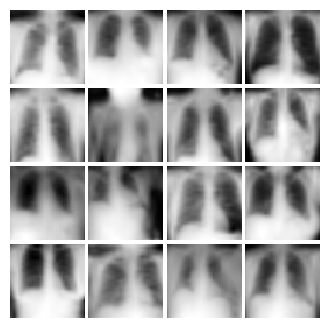


EPOCH:  24
Iter: 28250, D: 0.06537, G:4.195


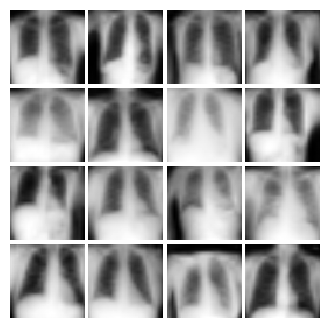


Iter: 28500, D: 1.02, G:1.442


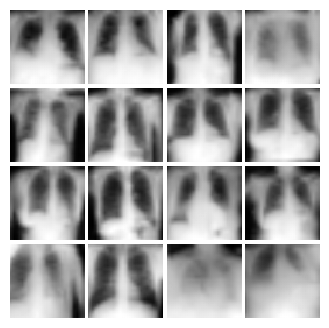


Iter: 28750, D: 0.3284, G:3.776


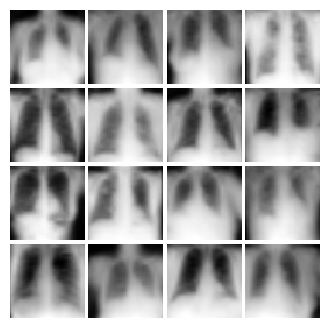


Iter: 29000, D: 0.7324, G:2.373


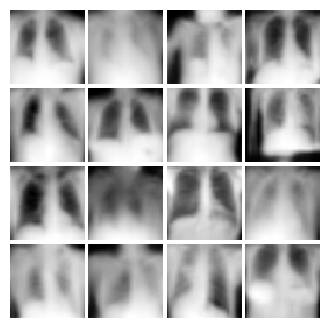


Iter: 29250, D: 1.255, G:4.291


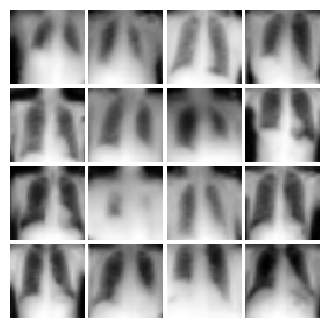


EPOCH:  25
Iter: 29500, D: 0.244, G:3.408


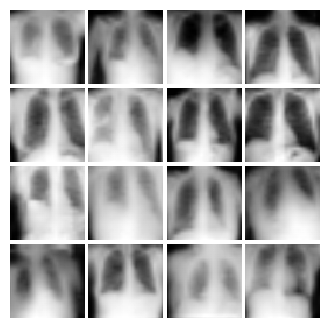


Iter: 29750, D: 0.03672, G:8.287


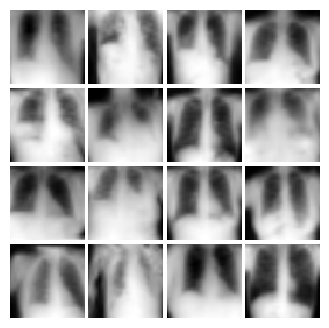


Iter: 30000, D: 0.2316, G:4.557


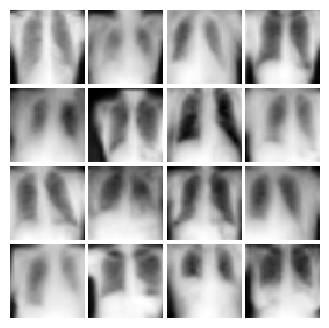


Iter: 30250, D: 0.1039, G:3.975


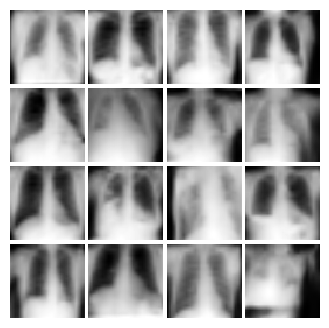


Iter: 30500, D: 0.5897, G:2.437


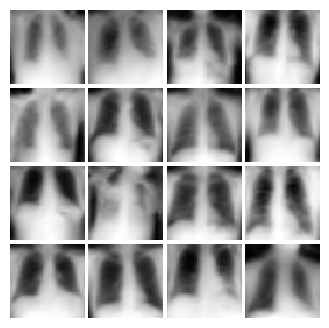


EPOCH:  26
Iter: 30750, D: 0.09008, G:3.659


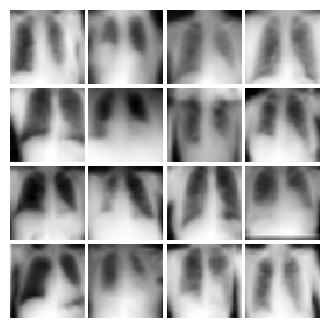


Iter: 31000, D: 0.18, G:2.59


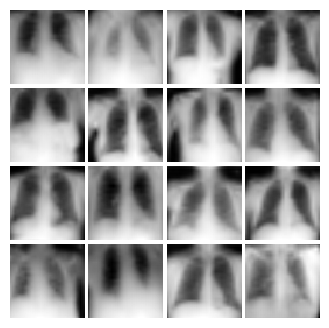


Iter: 31250, D: 1.258, G:4.622


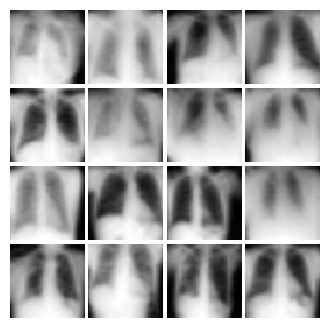


Iter: 31500, D: 0.2845, G:4.754


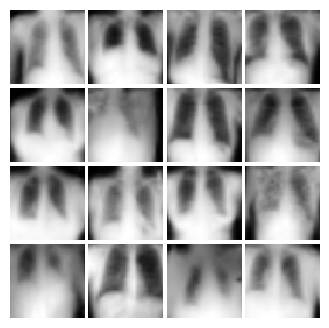


Iter: 31750, D: 0.1414, G:4.361


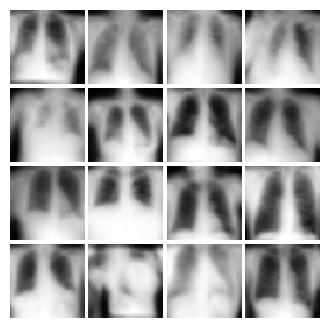


EPOCH:  27
Iter: 32000, D: 0.4988, G:1.735


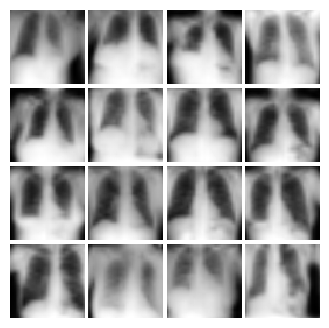


Iter: 32250, D: 0.6271, G:1.843


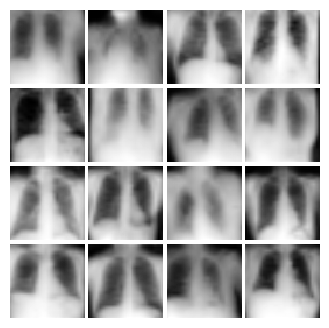


Iter: 32500, D: 1.016, G:1.514


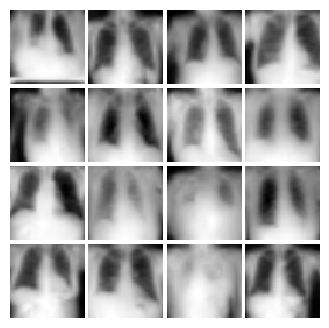


Iter: 32750, D: 0.1354, G:3.558


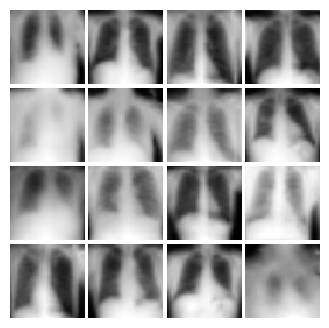


Iter: 33000, D: 0.3332, G:5.526


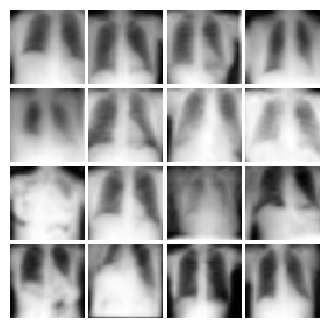


EPOCH:  28
Iter: 33250, D: 0.4159, G:2.185


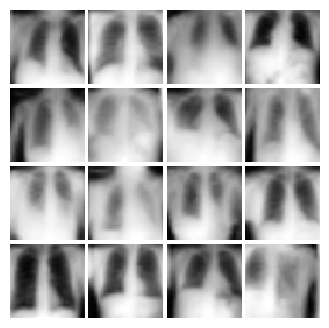


Iter: 33500, D: 0.5551, G:2.611


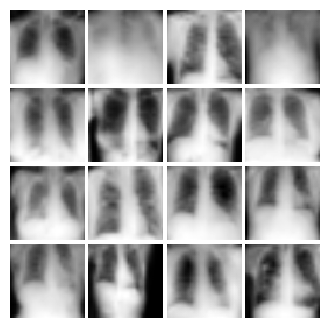


Iter: 33750, D: 0.1002, G:5.242


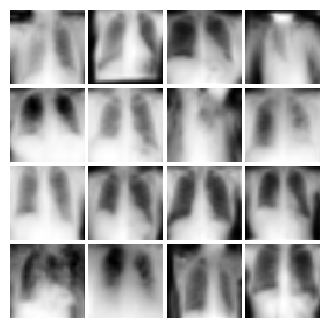


Iter: 34000, D: 1.443, G:0.5211


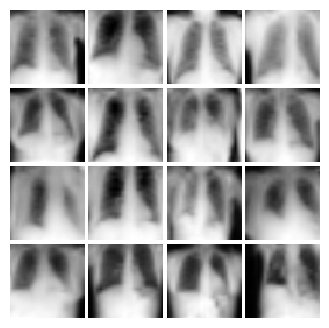


Iter: 34250, D: 0.1239, G:3.635


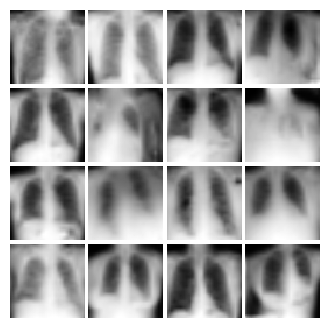


EPOCH:  29
Iter: 34500, D: 2.565, G:0.5099


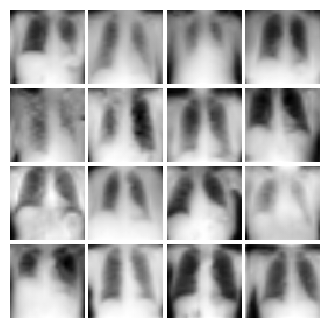


Iter: 34750, D: 0.1305, G:4.703


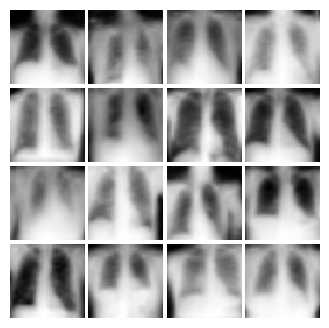


Iter: 35000, D: 0.2783, G:5.649


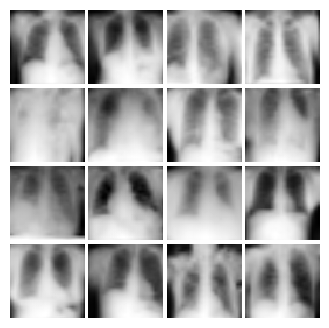


Iter: 35250, D: 0.2255, G:2.698


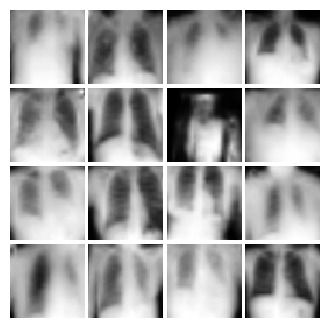


Iter: 35500, D: 0.4849, G:7.068


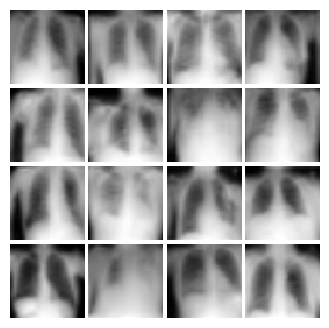


EPOCH:  30
Iter: 35750, D: 0.0654, G:3.19


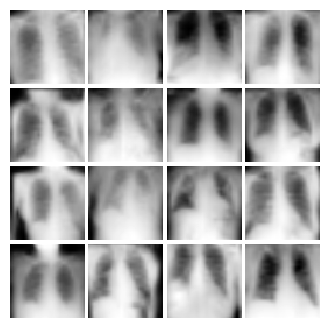


Iter: 36000, D: 0.7259, G:8.142


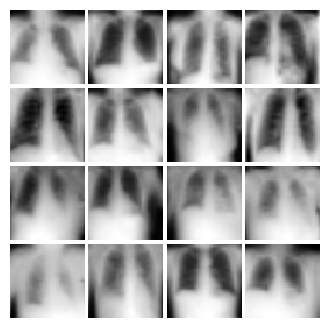


Iter: 36250, D: 0.1734, G:3.993


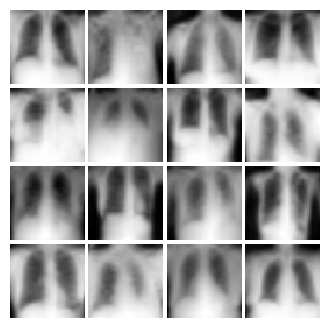


Iter: 36500, D: 0.3907, G:4.296


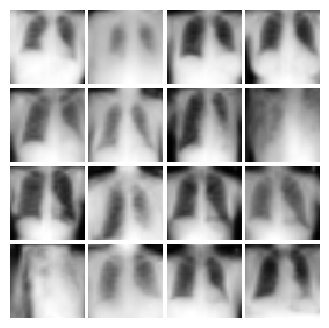


Iter: 36750, D: 1.346, G:1.409


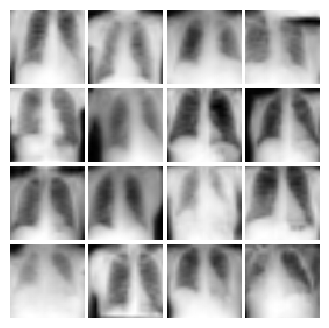


EPOCH:  31
Iter: 37000, D: 0.1223, G:4.046


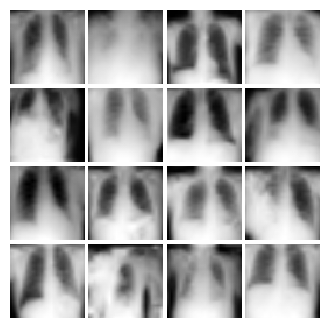


Iter: 37250, D: 0.07815, G:5.563


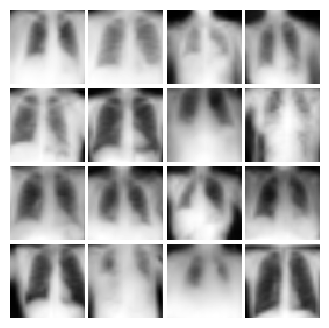


Iter: 37500, D: 0.0009992, G:9.557


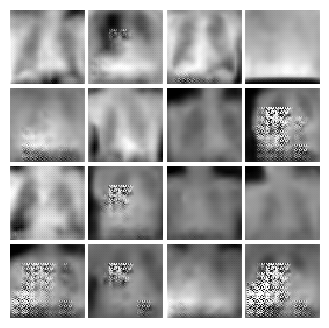


Iter: 37750, D: 8.577e-05, G:25.43


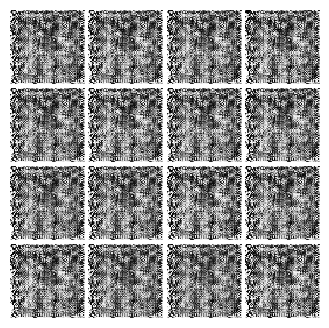


Iter: 38000, D: 17.47, G:30.51


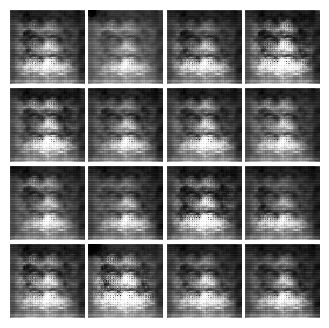


EPOCH:  32
Iter: 38250, D: 0.001754, G:8.137


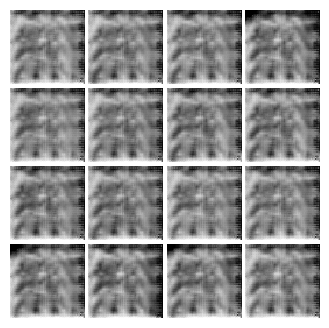


Iter: 38500, D: 0.002105, G:7.861


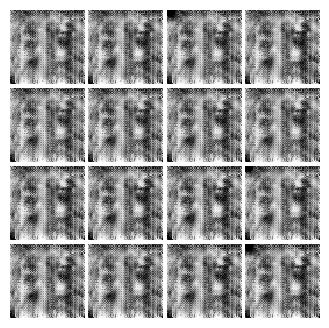


Iter: 38750, D: 0.0002893, G:9.994


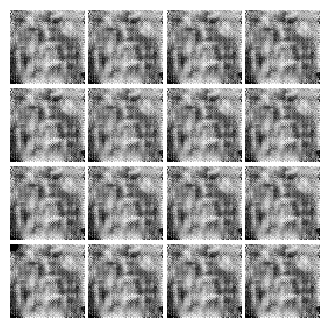


Iter: 39000, D: 0.0003596, G:9.516


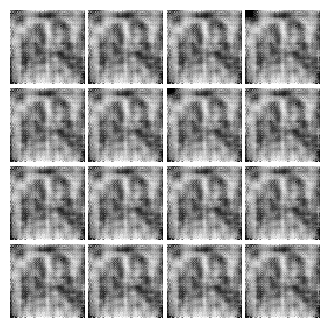


EPOCH:  33
Iter: 39250, D: 4.528e-05, G:18.52


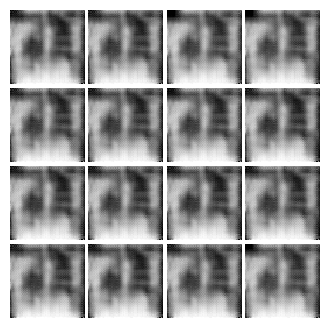


Iter: 39500, D: 0.008588, G:7.932


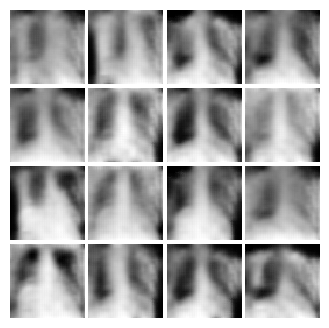


Iter: 39750, D: 0.004999, G:7.728


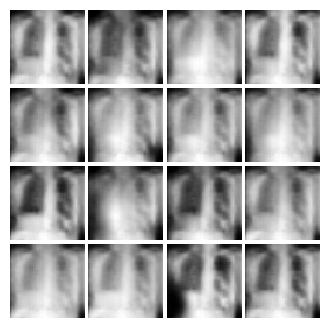


Iter: 40000, D: 0.003406, G:7.771


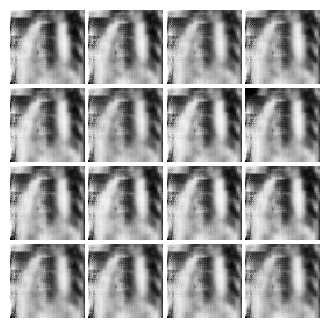


Iter: 40250, D: 0.001315, G:9.53


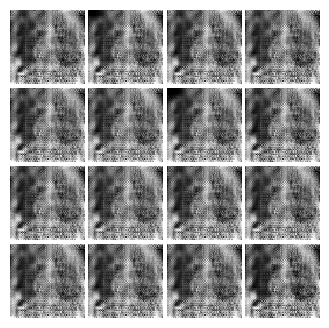


EPOCH:  34
Iter: 40500, D: 0.0001509, G:11.54


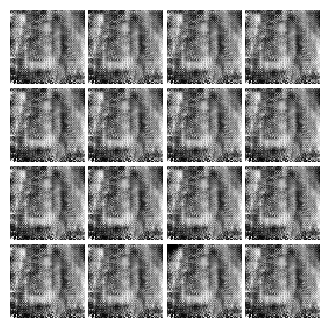


Iter: 40750, D: 0.0003662, G:8.266


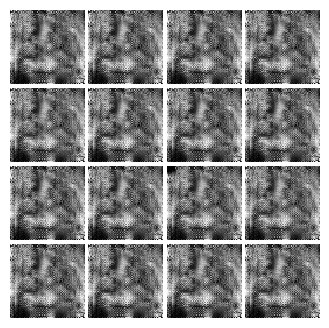


Iter: 41000, D: 0.0002374, G:9.288


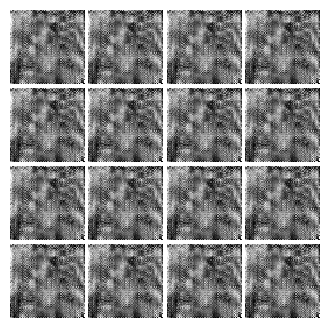


Iter: 41250, D: 2.142e-05, G:11.02


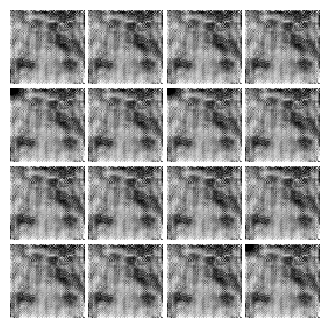


Iter: 41500, D: 1.008e-06, G:16.01


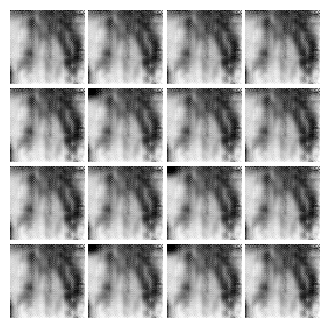


EPOCH:  35
Iter: 41750, D: 0.0002531, G:9.534


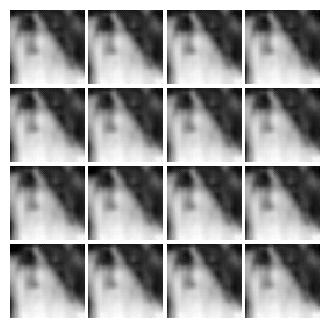


Iter: 42000, D: 0.08227, G:22.73


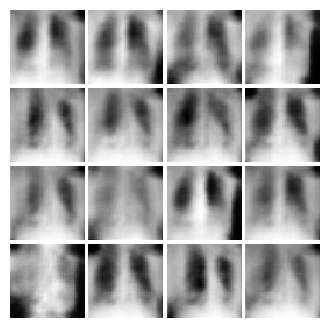


Iter: 42250, D: 0.004248, G:6.933


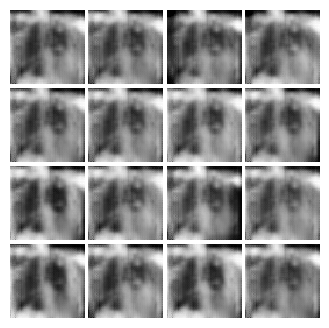


Iter: 42500, D: 0.003171, G:8.159


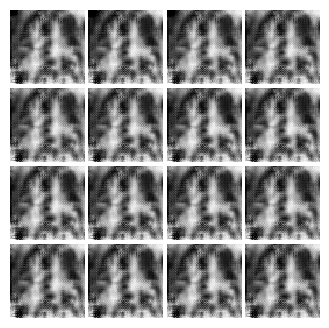


Iter: 42750, D: 0.002096, G:8.111


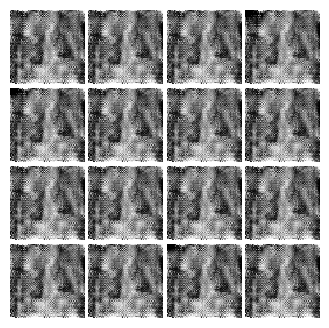


EPOCH:  36
Iter: 43000, D: 0.0009793, G:10.61


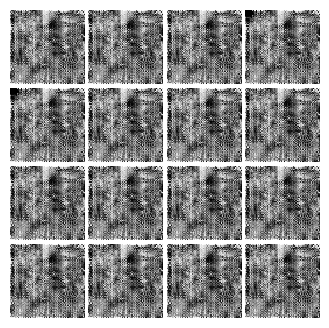


Iter: 43250, D: 0.0001128, G:9.877


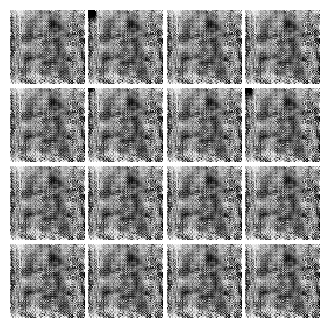


Iter: 43500, D: 6.919e-05, G:11.85


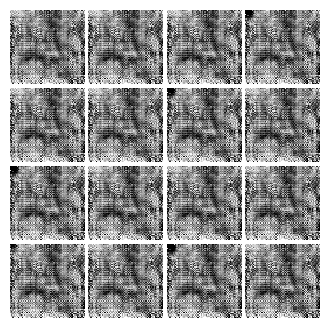


Iter: 43750, D: 9.892e-05, G:9.423


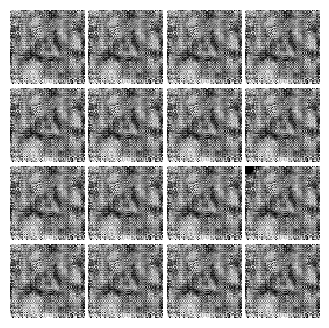


Iter: 44000, D: 5.757e-05, G:12.04


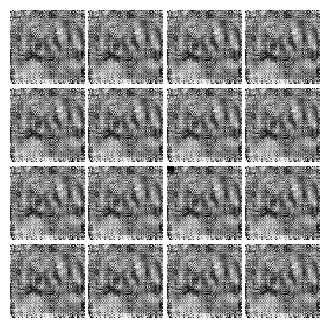


EPOCH:  37
Iter: 44250, D: 3.113e-05, G:10.72


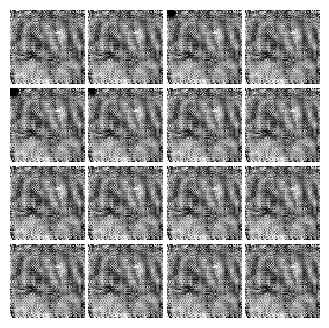


Iter: 44500, D: 4.043e-05, G:11.19


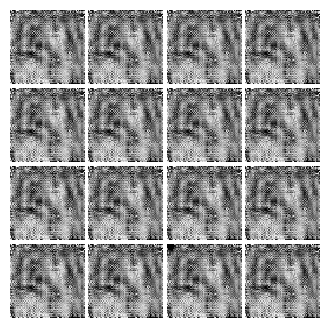


Iter: 44750, D: 5.881e-06, G:12.65


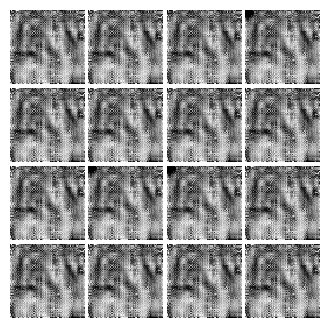


Iter: 45000, D: 3.999e-05, G:10.11


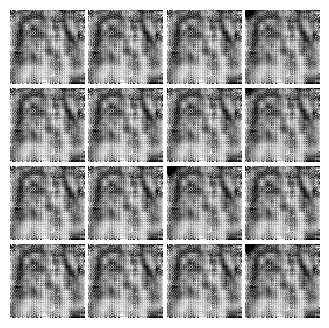


Iter: 45250, D: 7.386e-06, G:12.56


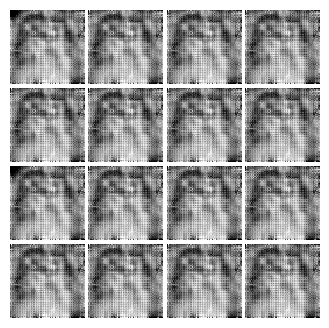


EPOCH:  38
Iter: 45500, D: 1.713e-05, G:11.84


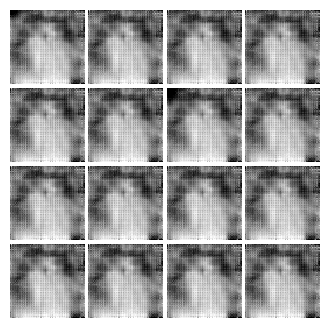


Iter: 45750, D: 2.116, G:19.13


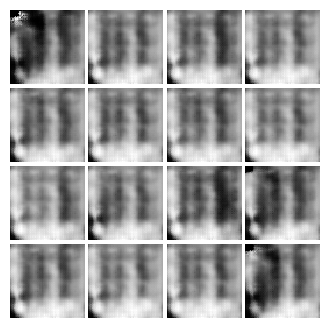


Iter: 46000, D: 0.8822, G:9.886


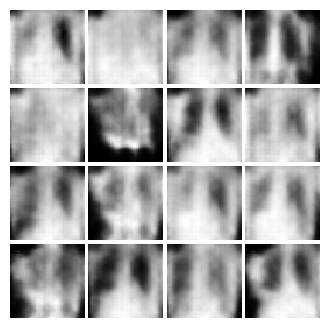


Iter: 46250, D: 0.02786, G:8.245


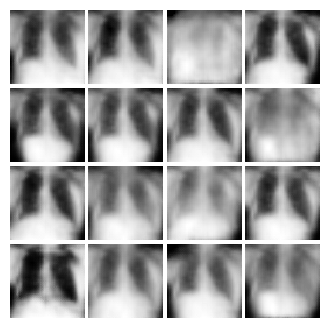


Iter: 46500, D: 0.04795, G:5.901


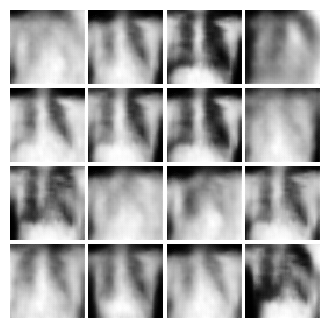


EPOCH:  39
Iter: 46750, D: 0.004918, G:7.673


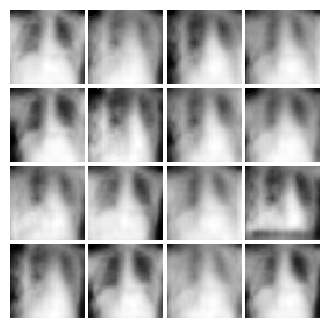


Iter: 47000, D: 0.02676, G:5.466


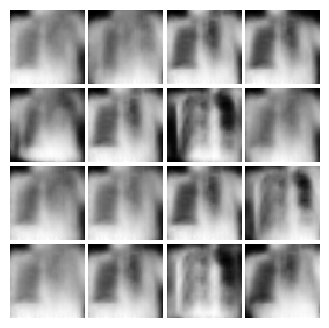


Iter: 47250, D: 0.02847, G:10.52


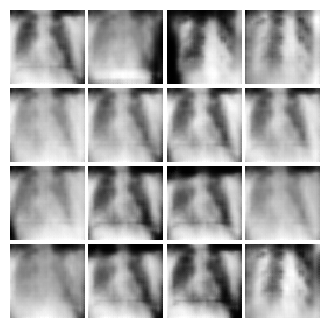


Iter: 47500, D: 0.004006, G:6.703


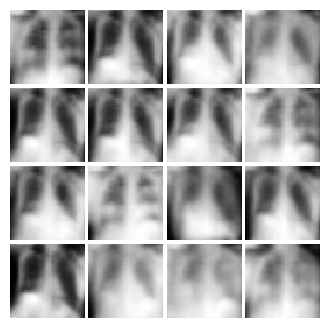


Iter: 47750, D: 0.02864, G:9.395


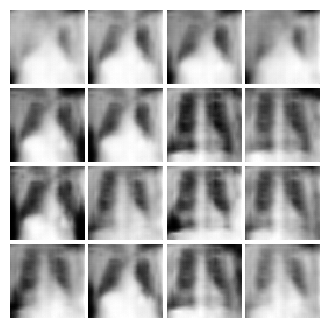


EPOCH:  40
Iter: 48000, D: 0.02004, G:5.48


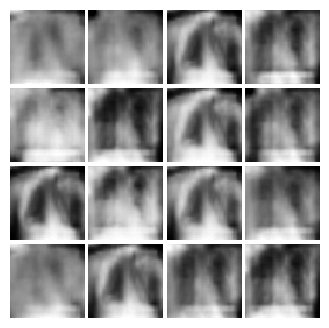


Iter: 48250, D: 0.008766, G:10.58


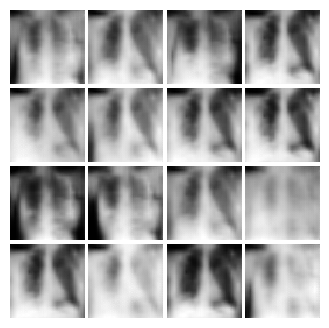


Iter: 48500, D: 0.1772, G:14.11


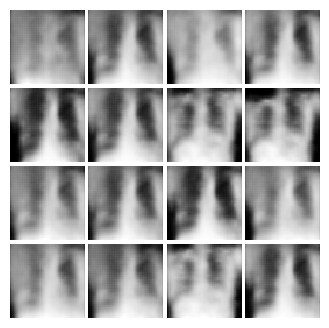


Iter: 48750, D: 0.004188, G:10.66


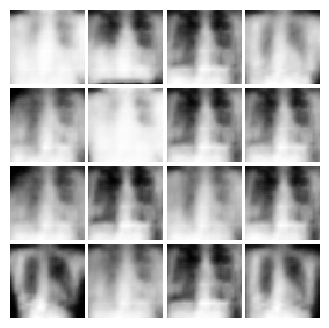


Iter: 49000, D: 0.02107, G:7.889


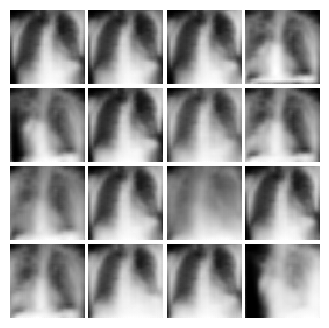


EPOCH:  41
Iter: 49250, D: 0.002117, G:9.524


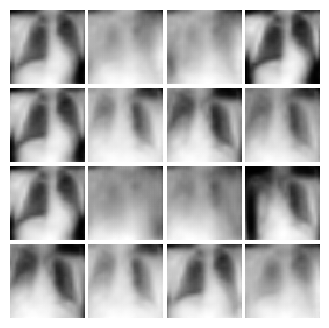


Iter: 49500, D: 0.6585, G:15.99


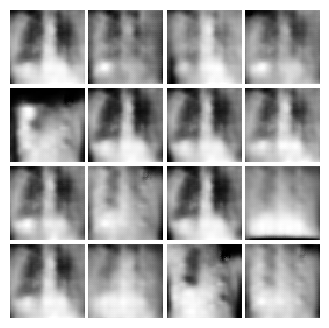


Iter: 49750, D: 0.08731, G:14.68


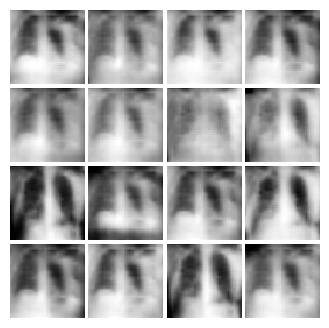


Iter: 50000, D: 0.02784, G:15.08


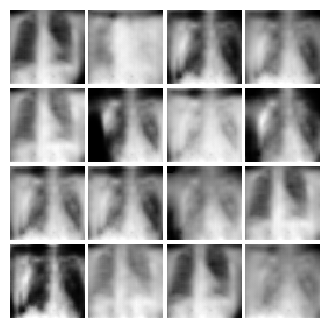


Iter: 50250, D: 0.01628, G:5.845


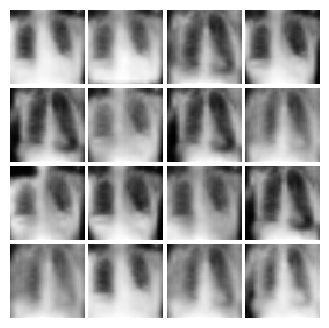


EPOCH:  42
Iter: 50500, D: 0.002642, G:10.93


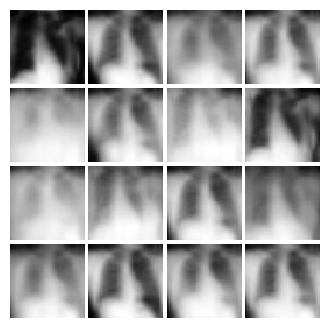


Iter: 50750, D: 0.003201, G:6.334


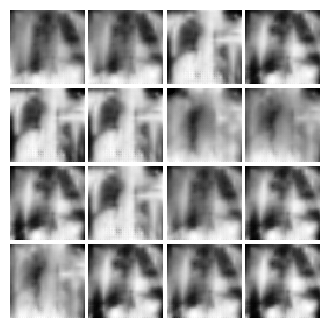


Iter: 51000, D: 0.0308, G:10.95


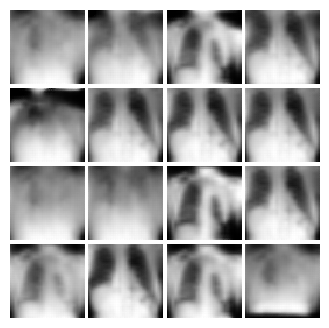


Iter: 51250, D: 0.8301, G:26.96


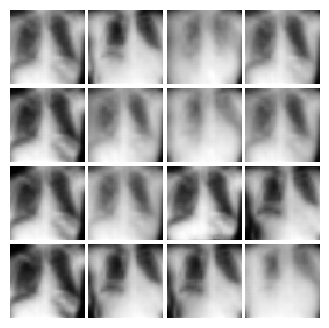


EPOCH:  43
Iter: 51500, D: 0.03902, G:6.006


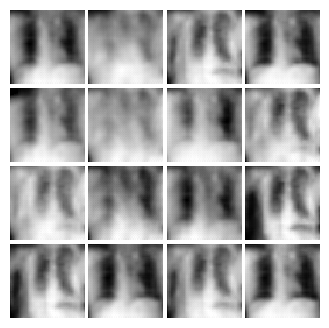


Iter: 51750, D: 0.0002876, G:16.74


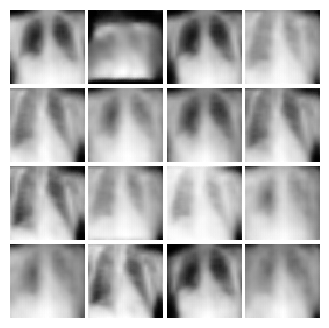


Iter: 52000, D: 0.06024, G:23.42


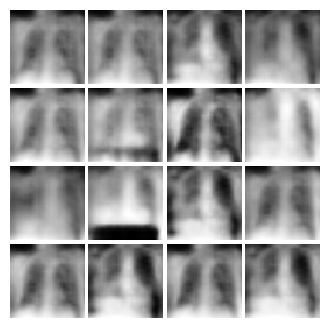


Iter: 52250, D: 0.01679, G:7.732


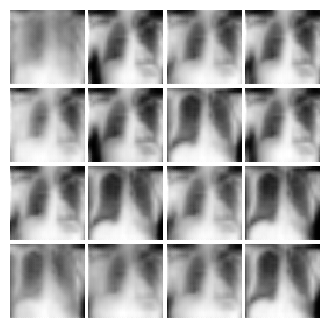


Iter: 52500, D: 0.004279, G:7.107


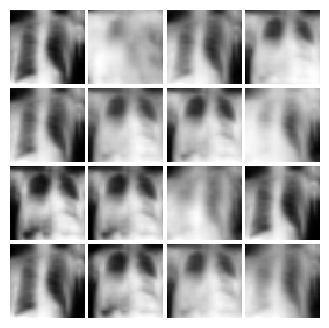


EPOCH:  44
Iter: 52750, D: 0.002614, G:6.18


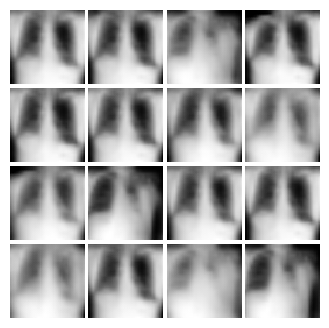


Iter: 53000, D: 0.004265, G:7.661


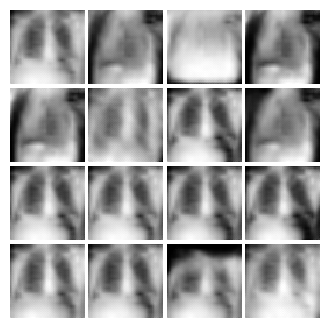


Iter: 53250, D: 0.00678, G:7.621


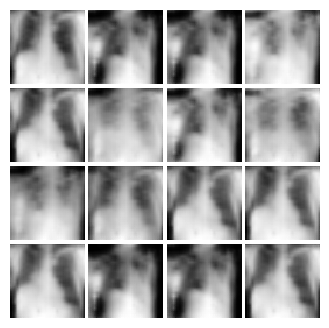


Iter: 53500, D: 0.01388, G:8.851


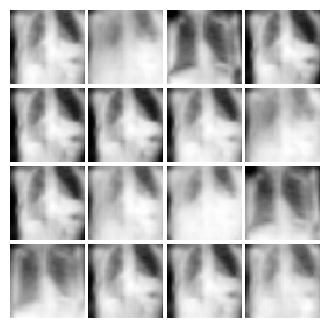


Iter: 53750, D: 0.02433, G:6.203


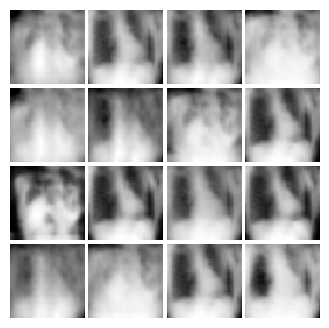


EPOCH:  45
Iter: 54000, D: 0.005489, G:10.16


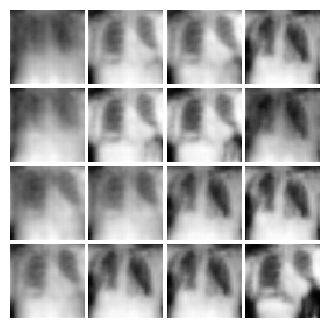


Iter: 54250, D: 0.01299, G:7.124


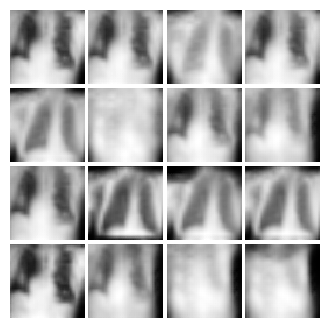


Iter: 54500, D: 0.07403, G:20.19


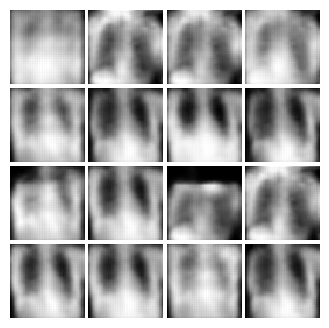


Iter: 54750, D: 0.04773, G:9.43


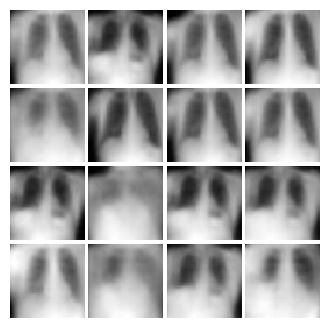


Iter: 55000, D: 0.005911, G:8.96


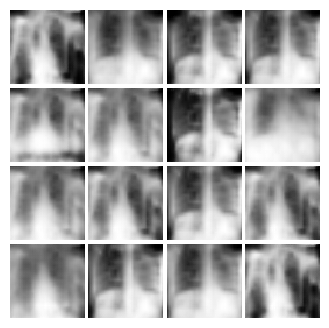


EPOCH:  46
Iter: 55250, D: 0.009305, G:7.308


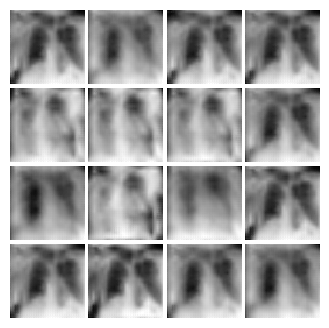


Iter: 55500, D: 0.01199, G:8.384


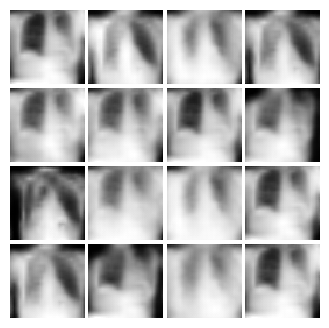


Iter: 55750, D: 0.002911, G:9.93


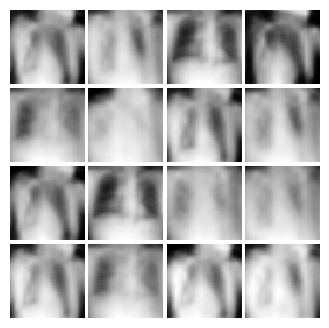


Iter: 56000, D: 0.03313, G:11.11


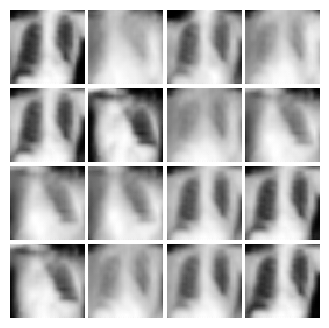


Iter: 56250, D: 0.4008, G:35.67


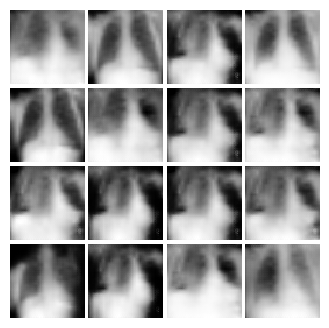


EPOCH:  47
Iter: 56500, D: 0.02777, G:7.924


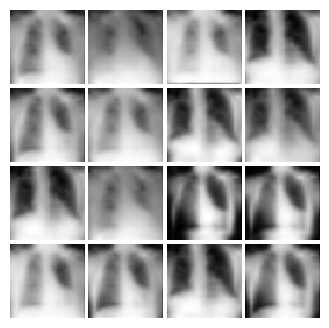


Iter: 56750, D: 0.03055, G:5.36


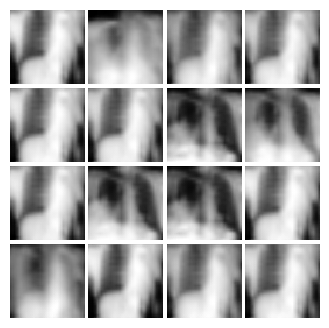


Iter: 57000, D: 0.007085, G:8.663


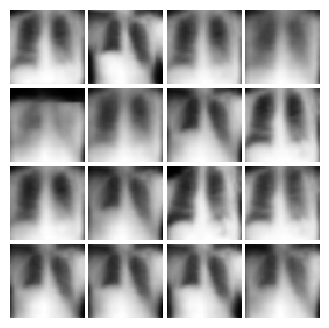


Iter: 57250, D: 0.00137, G:7.383


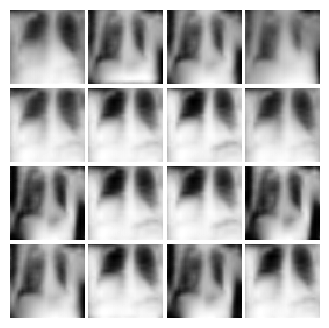


Iter: 57500, D: 0.005497, G:7.541


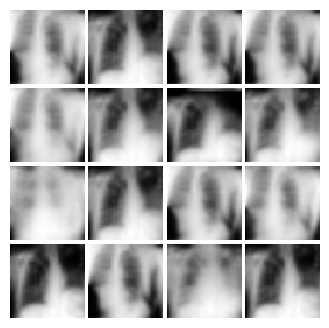


EPOCH:  48
Iter: 57750, D: 0.0009441, G:21.63


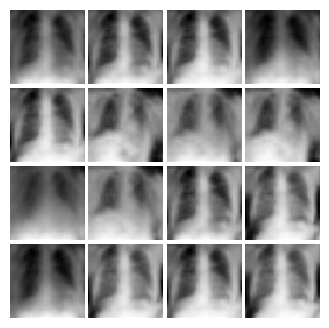


Iter: 58000, D: 0.004159, G:4.458


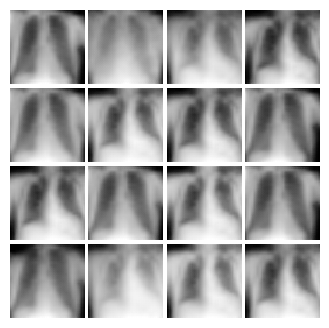


Iter: 58250, D: 0.3061, G:6.985


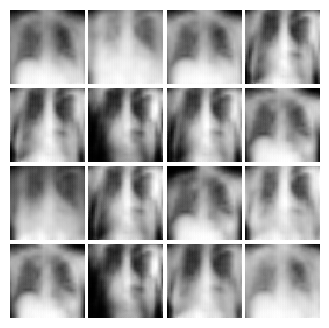


Iter: 58500, D: 0.001502, G:7.149


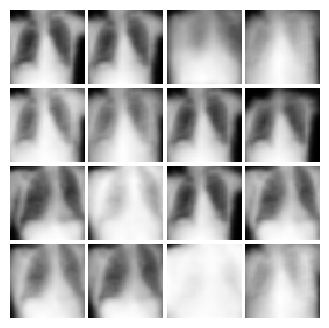


Iter: 58750, D: 0.01554, G:7.12


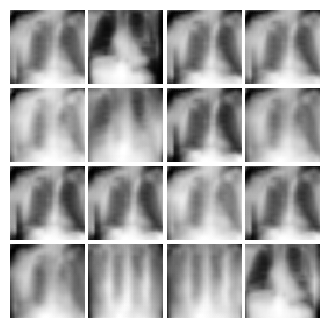


EPOCH:  49
Iter: 59000, D: 0.002652, G:12.3


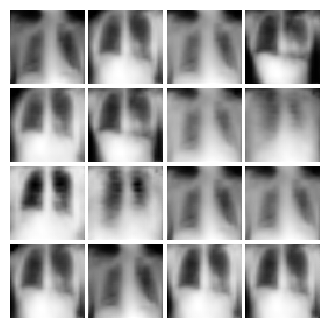


Iter: 59250, D: 0.05645, G:11.79


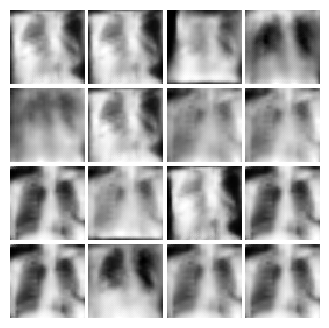


Iter: 59500, D: 0.00318, G:5.698


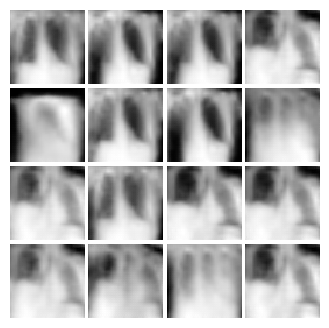


Iter: 59750, D: 0.03065, G:7.198


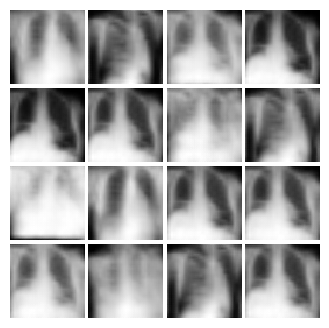


Iter: 60000, D: 0.009655, G:5.957


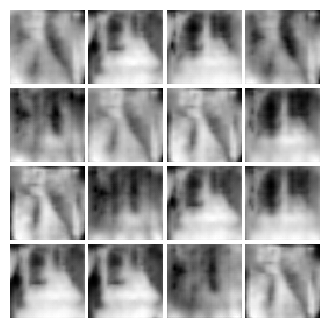


EPOCH:  50
Iter: 60250, D: 0.08325, G:9.369


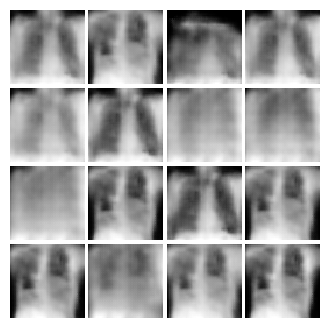


Iter: 60500, D: 0.002186, G:7.016


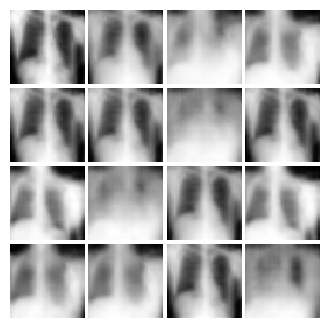


Iter: 60750, D: 0.005164, G:7.316


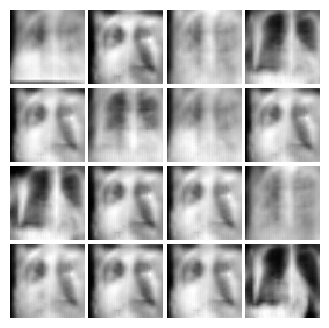


Iter: 61000, D: 0.0223, G:6.72


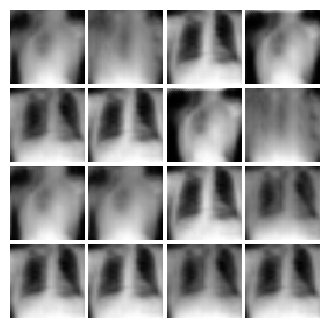


Iter: 61250, D: 0.653, G:23.16


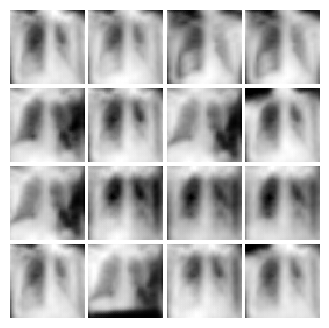

In [81]:
train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=loader_train, device=device)